## Credit Risk Preprocessing:

In [1]:
import numpy as np
import pandas as pd

In [3]:
#Back up just in case:
load_data_backup = pd.read_csv('loan_data_2007_2014.csv')

/var/folders/k_/p3kns8712g36qk02pv5vmss40000gn/T/ipykernel_92285/3573727763.py:1: DtypeWarning: Columns (20) have mixed types. Specify dtype option on import or set low_memory=False.
  load_data_backup = pd.read_csv('loan_data_2007_2014.csv')


In [7]:
loan_data = load_data_backup.copy()
pd.options.display.max_columns = None #Display all columns
loan_data

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.00,0.00,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-99,5.0,NaN,NaN,3.0,0.0,1687,9.4,4.0,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-01,2.0,NaN,NaN,2.0,0.0,2956,98.5,10.0,f,0.00,0.00,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.00,Jun-14,649.91,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-96,1.0,35.0,NaN,10.0,0.0,5598,21.0,37.0,f,0.00,0.00,12226.302210,12226.30,10000.00,2209.33,16.97,0.00,0.00,Jan-15,357.48,NaN,Jan-15,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-11,Current,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-96,0.0,38.0,NaN,15.0,0.0,27783,53.9,38.0,f,766.90,766.90,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.00,Jan-16,67.79,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,466280,8598660,1440975,18400,18400,18400.0,60 months,14.47,432.64,C,C2,Financial Advisor,4 years,MORTGAGE,110000.0,Source Verified,Jan-14,Current,n,https://www.lendingclub.com/browse/loanDetail....,NaN,debt_consolidation,Debt consolidation,773

In [10]:
loan_data.columns.values

array(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'veri

In [12]:
#to check types of each column:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 75 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Unnamed: 0                   466285 non-null  int64  
 1   id                           466285 non-null  int64  
 2   member_id                    466285 non-null  int64  
 3   loan_amnt                    466285 non-null  int64  
 4   funded_amnt                  466285 non-null  int64  
 5   funded_amnt_inv              466285 non-null  float64
 6   term                         466285 non-null  object 
 7   int_rate                     466285 non-null  float64
 8   installment                  466285 non-null  float64
 9   grade                        466285 non-null  object 
 10  sub_grade                    466285 non-null  object 
 11  emp_title                    438697 non-null  object 
 12  emp_length                   445277 non-null  object 
 13 

# General Preprocessing:
# Preprocessing few continuous variables


In [13]:
#All in string with 'years', '+', '<'
loan_data['emp_length'].unique()

array(['10+ years', '< 1 year', '1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '6 years', '2 years', '7 years', nan],
      dtype=object)

In [25]:
#Converting all to numerical values:
loan_data['emp_length_int'] = loan_data['emp_length'].str.extract('(\d+)').astype(float)
loan_data['emp_length_int'] = loan_data['emp_length_int'].fillna(loan_data['emp_length_int'].replace(np.nan, 0))
print(loan_data['emp_length_int'])

0         10.0
1          1.0
2         10.0
3         10.0
4          1.0
          ... 
466280     4.0
466281    10.0
466282     7.0
466283     3.0
466284    10.0
Name: emp_length_int, Length: 466285, dtype: float64


In [28]:
loan_data['earliest_cr_line']

0         Jan-85
1         Apr-99
2         Nov-01
3         Feb-96
4         Jan-96
           ...  
466280    Apr-03
466281    Jun-97
466282    Dec-01
466283    Feb-03
466284    Feb-00
Name: earliest_cr_line, Length: 466285, dtype: object

In [29]:
loan_data['earliest_cr_line_date'] = pd.to_datetime(loan_data['earliest_cr_line'], format= '%b-%y')

In [30]:
#Number of days between the time, the earliest credit line and December 2017:
pd.to_datetime('2017-12-01') - loan_data['earliest_cr_line_date']

0        12022 days
1         6819 days
2         5874 days
3         7974 days
4         8005 days
            ...    
466280    5358 days
466281    7488 days
466282    5844 days
466283    5417 days
466284    6513 days
Name: earliest_cr_line_date, Length: 466285, dtype: timedelta64[ns]

In [31]:
#Converting into months:
loan_data['mths_since_earliest_cr_line'] = round(pd.to_numeric((pd.to_datetime('2017-12-01') - loan_data['earliest_cr_line_date'])/ np.timedelta64(1, 'M')))

#Diplay descriptive statistics: (days cannot be negative - min value)
loan_data['mths_since_earliest_cr_line'].describe()

count    466256.000000
mean        239.482430
std          93.974829
min        -612.000000
25%         183.000000
50%         225.000000
75%         285.000000
max         587.000000
Name: mths_since_earliest_cr_line, dtype: float64

In [32]:
#Display negative mnths:
loan_data.loc[:,['earliest_cr_line', 'earliest_cr_line_date', 'mths_since_earliest_cr_line']][loan_data['mths_since_earliest_cr_line'] < 0]

,earliest_cr_line,earliest_cr_line_date,mths_since_earliest_cr_line
1580,Sep-62,2062-09-01,-537.0
1770,Sep-68,2068-09-01,-609.0
2799,Sep-64,2064-09-01,-561.0
3282,Sep-67,2067-09-01,-597.0
3359,Feb-65,2065-02-01,-566.0
...,...,...,...
464003,Jan-68,2068-01-01,-601.0
464260,Jul-66,2066-07-01,-583.0
465100,Oct-67,2067-10-01,-598.0
465500,Sep-67,2067-09-01,-597.0


In [33]:
#Substitute negative values with the maximum observed, normal or positive difference:
loan_data['mths_since_earliest_cr_line'][loan_data['mths_since_earliest_cr_line'] < 0] = loan_data['mths_since_earliest_cr_line'].max()

#Check minimum of month since earliest credit line to be positive:
min(loan_data['mths_since_earliest_cr_line'])

/var/folders/k_/p3kns8712g36qk02pv5vmss40000gn/T/ipykernel_92285/293130997.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data['mths_since_earliest_cr_line'][loan_data['mths_since_earliest_cr_line'] < 0] = loan_data['mths_since_earliest_cr_line'].max()


73.0

In [35]:
loan_data['term'].unique()

array([' 36 months', ' 60 months'], dtype=object)

In [37]:
loan_data['term_int'] = loan_data['term'].str.extract('(\d+)').astype(float)
print(loan_data['term_int'].unique())

[36. 60.]


In [38]:
loan_data['issue_d'].unique()

array(['Dec-11', 'Nov-11', 'Oct-11', 'Sep-11', 'Aug-11', 'Jul-11',
       'Jun-11', 'May-11', 'Apr-11', 'Mar-11', 'Feb-11', 'Jan-11',
       'Dec-10', 'Nov-10', 'Oct-10', 'Sep-10', 'Aug-10', 'Jul-10',
       'Jun-10', 'May-10', 'Apr-10', 'Mar-10', 'Feb-10', 'Jan-10',
       'Dec-09', 'Nov-09', 'Oct-09', 'Sep-09', 'Aug-09', 'Jul-09',
       'Jun-09', 'May-09', 'Apr-09', 'Mar-09', 'Feb-09', 'Jan-09',
       'Dec-08', 'Nov-08', 'Oct-08', 'Sep-08', 'Aug-08', 'Jul-08',
       'Jun-08', 'May-08', 'Apr-08', 'Mar-08', 'Feb-08', 'Jan-08',
       'Dec-07', 'Nov-07', 'Oct-07', 'Sep-07', 'Aug-07', 'Jul-07',
       'Jun-07', 'Dec-13', 'Nov-13', 'Oct-13', 'Sep-13', 'Aug-13',
       'Jul-13', 'Jun-13', 'May-13', 'Apr-13', 'Mar-13', 'Feb-13',
       'Jan-13', 'Dec-12', 'Nov-12', 'Oct-12', 'Sep-12', 'Aug-12',
       'Jul-12', 'Jun-12', 'May-12', 'Apr-12', 'Mar-12', 'Feb-12',
       'Jan-12', 'Dec-14', 'Nov-14', 'Oct-14', 'Sep-14', 'Aug-14',
       'Jul-14', 'Jun-14', 'May-14', 'Apr-14', 'Mar-14', 'Feb-

In [39]:
loan_data['issue_d_date'] = pd.to_datetime(loan_data['issue_d'], format= '%b-%y')

In [40]:
#Converting into months:
loan_data['mths_since_issue_d'] = round(pd.to_numeric((pd.to_datetime('2017-12-01') - loan_data['issue_d_date'])/ np.timedelta64(1, 'M')))

#Diplay descriptive statistics:
loan_data['mths_since_issue_d'].describe()

count    466285.000000
mean         51.255187
std          14.340154
min          36.000000
25%          41.000000
50%          47.000000
75%          57.000000
max         126.000000
Name: mths_since_issue_d, dtype: float64

## Preprocessing discrete variables:

In [41]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 81 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   Unnamed: 0                   466285 non-null  int64         
 1   id                           466285 non-null  int64         
 2   member_id                    466285 non-null  int64         
 3   loan_amnt                    466285 non-null  int64         
 4   funded_amnt                  466285 non-null  int64         
 5   funded_amnt_inv              466285 non-null  float64       
 6   term                         466285 non-null  object        
 7   int_rate                     466285 non-null  float64       
 8   installment                  466285 non-null  float64       
 9   grade                        466285 non-null  object        
 10  sub_grade                    466285 non-null  object        
 11  emp_title                 

In [44]:
#Dummy variables being created for grade:
pd.get_dummies(loan_data['grade'], prefix='Grade ', prefix_sep=': ')

,Grade : A,Grade : B,Grade : C,Grade : D,Grade : E,Grade : F,Grade : G
0,0,1,0,0,0,0,0
1,0,0,1,0,0,0,0
2,0,0,1,0,0,0,0
3,0,0,1,0,0,0,0
4,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...
466280,0,0,1,0,0,0,0
466281,0,0,0,1,0,0,0
466282,0,0,0,1,0,0,0
466283,1,0,0,0,0,0,0


In [49]:
loan_data_dummies = [pd.get_dummies(loan_data['grade'], prefix='grade', prefix_sep=':'),
                     pd.get_dummies(loan_data['sub_grade'], prefix='sub_grade', prefix_sep=':'),
                     pd.get_dummies(loan_data['home_ownership'], prefix='home_ownership', prefix_sep=':'),
                     pd.get_dummies(loan_data['verification_status'], prefix='verification_status', prefix_sep=':'),
                     pd.get_dummies(loan_data['loan_status'], prefix='loan_status', prefix_sep=':'),
                     pd.get_dummies(loan_data['purpose'], prefix='purpose', prefix_sep=':'),
                     pd.get_dummies(loan_data['addr_state'], prefix='addr_state', prefix_sep=':'),
                     pd.get_dummies(loan_data['initial_list_status'], prefix='initial_list_status', prefix_sep=':')]

In [50]:
#Make it a Dataframe:
loan_data_dummies = pd.concat(loan_data_dummies, axis=1)
type(loan_data_dummies)

pandas.core.frame.DataFrame

In [51]:
loan_data = pd.concat([loan_data, loan_data_dummies], axis=1)
loan_data.columns.values

array(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'veri

In [58]:
#Dealing with missing values:
pd.options.display.max_rows = None
missing_values = loan_data.isnull().sum()
columns_with_missing = missing_values[missing_values > 0]

# Display columns with missing values and their counts of NaN
print(columns_with_missing)


emp_title                       27588
emp_length                      21008
annual_inc                          4
desc                           340302
title                              20
delinq_2yrs                        29
earliest_cr_line                   29
inq_last_6mths                     29
mths_since_last_delinq         250351
mths_since_last_record         403647
open_acc                           29
pub_rec                            29
revol_util                        340
total_acc                          29
last_pymnt_d                      376
next_pymnt_d                   227214
last_credit_pull_d                 42
collections_12_mths_ex_med        145
mths_since_last_major_derog    367311
annual_inc_joint               466285
dti_joint                      466285
verification_status_joint      466285
acc_now_delinq                     29
tot_coll_amt                    70276
tot_cur_bal                     70276
open_acc_6m                    466285
open_il_6m  

In [59]:
#Replace na:
loan_data['total_rev_hi_lim'].fillna(loan_data['funded_amnt'], inplace= True)
loan_data['total_rev_hi_lim'].isnull().sum()

0

In [60]:
#Fill missing values with the mean of the non-missing values:
loan_data['annual_inc'].fillna(loan_data['annual_inc'].mean(), inplace=True)

#Fill missing values with zeroes:
loan_data['mths_since_earliest_cr_line'].fillna(0, inplace=True)
loan_data['acc_now_delinq'].fillna(0, inplace=True)
loan_data['total_acc'].fillna(0, inplace=True)
loan_data['pub_rec'].fillna(0, inplace=True)
loan_data['open_acc'].fillna(0, inplace=True)
loan_data['inq_last_6mths'].fillna(0, inplace=True)
loan_data['delinq_2yrs'].fillna(0, inplace=True)
loan_data['emp_length_int'].fillna(0, inplace=True)

PD Model: Data Preparation
Dependant Variables


In [62]:
#Loan Status
loan_data['loan_status'].unique()

#Good: Fully Paid, Current, In Grace Period

array(['Fully Paid', 'Charged Off', 'Current', 'Default',
       'Late (31-120 days)', 'In Grace Period', 'Late (16-30 days)',
       'Does not meet the credit policy. Status:Fully Paid',
       'Does not meet the credit policy. Status:Charged Off'],
      dtype=object)

In [63]:
loan_data['loan_status'].value_counts()

Current                                                224226
Fully Paid                                             184739
Charged Off                                             42475
Late (31-120 days)                                       6900
In Grace Period                                          3146
Does not meet the credit policy. Status:Fully Paid       1988
Late (16-30 days)                                        1218
Default                                                   832
Does not meet the credit policy. Status:Charged Off       761
Name: loan_status, dtype: int64

In [66]:
loan_data['loan_status'].value_counts() / loan_data['loan_status'].count() * 100

Current                                                48.087757
Fully Paid                                             39.619332
Charged Off                                             9.109236
Late (31-120 days)                                      1.479782
In Grace Period                                         0.674695
Does not meet the credit policy. Status:Fully Paid      0.426349
Late (16-30 days)                                       0.261214
Default                                                 0.178432
Does not meet the credit policy. Status:Charged Off     0.163205
Name: loan_status, dtype: float64

In [68]:
# np.where() check if condition is true, return specific value if true:
loan_data['good_bad'] = np.where(loan_data['loan_status'].isin(['Charged Off','Default', 'Does not meet the credit policy. Status:Charged Off','Late (31-120 days)']), 0, 1)
loan_data['good_bad']

0         1
1         0
2         1
3         1
4         1
5         1
6         1
7         1
8         0
9         0
10        1
11        1
12        0
13        1
14        0
15        1
16        1
17        1
18        1
19        1
20        1
21        0
22        1
23        1
24        0
25        1
26        0
27        0
28        1
29        1
30        1
31        1
32        1
33        1
34        1
35        1
36        1
37        1
38        1
39        1
40        1
41        1
42        1
43        1
44        1
45        1
46        0
47        1
48        1
49        1
50        0
51        1
52        1
53        0
54        1
55        0
56        1
57        1
58        1
59        1
60        1
61        1
62        1
63        1
64        0
65        1
66        0
67        1
68        0
69        1
70        1
71        0
72        1
73        1
74        1
75        1
76        1
77        1
78        1
79        1
80        1
81        1
82        1
83  

In [71]:
from sklearn.model_selection import train_test_split


In [76]:
x_train, x_test, y_train, y_test = train_test_split(loan_data.drop('good_bad', axis = 1), loan_data['good_bad'], test_size = 0.2, random_state=42)

print(f"Shape of x_train: {x_train.shape}")
print(f"Shape of x_test: {x_test.shape}")
print(f"Shape of y_train: {y_train.shape}")
print(f"Shape of y_test: {y_test.shape}")

Shape of x_train: (373028, 207)
Shape of x_test: (93257, 207)
Shape of y_train: (373028,)
Shape of y_test: (93257,)


In [77]:
x_train['grade'].unique()

array(['A', 'C', 'D', 'B', 'E', 'F', 'G'], dtype=object)

In [81]:
#Store only indepedant variable grade:
df1 = pd.concat([x_train['grade'], y_train], axis=1)
df1.head()

,grade,good_bad
427211,A,1
206088,C,1
136020,A,1
412305,D,0
36159,C,0


In [87]:
count_df1 = df1.groupby(df1.columns.values[0], as_index = False)[df1.columns.values[1]].count()
count_df1

,grade,good_bad
0,A,59759
1,B,109730
2,C,100245
3,D,61498
4,E,28612
5,F,10530
6,G,2654


In [86]:
mean_df1 = df1.groupby(df1.columns.values[0], as_index = False)[df1.columns.values[1]].mean()
mean_df1

,grade,good_bad
0,A,0.961044
1,B,0.921015
2,C,0.885770
3,D,0.846304
4,E,0.805257
5,F,0.754416
6,G,0.727958


In [90]:
df1 = pd.concat([count_df1, mean_df1], axis=1) 
df1

,grade,good_bad,grade,good_bad
0,A,59759,A,0.961044
1,B,109730,B,0.921015
2,C,100245,C,0.885770
3,D,61498,D,0.846304
4,E,28612,E,0.805257
5,F,10530,F,0.754416
6,G,2654,G,0.727958


In [94]:
#Display only 1st, 2nd and 4th column:
df1 = df1.iloc[: ,[0, 1, 3]]
df1

,grade,good_bad,good_bad
0,A,59759,0.961044
1,B,109730,0.921015
2,C,100245,0.885770
3,D,61498,0.846304
4,E,28612,0.805257
5,F,10530,0.754416
6,G,2654,0.727958


In [95]:
#Changing the header names:
df1.columns = [df1.columns.values[0], 'num_obs', 'prop_good']
df1

,grade,num_obs,prop_good
0,A,59759,0.961044
1,B,109730,0.921015
2,C,100245,0.885770
3,D,61498,0.846304
4,E,28612,0.805257
5,F,10530,0.754416
6,G,2654,0.727958


In [96]:
df1['prop_num_obs'] = df1['num_obs'] / df1['num_obs'].sum()
df1

,grade,num_obs,prop_good,prop_num_obs
0,A,59759,0.961044,0.160200
1,B,109730,0.921015,0.294160
2,C,100245,0.885770,0.268733
3,D,61498,0.846304,0.164862
4,E,28612,0.805257,0.076702
5,F,10530,0.754416,0.028228
6,G,2654,0.727958,0.007115


In [97]:
#Display number of good and bad observations:
df1['n_good'] = df1['prop_good'] * df1['num_obs']
df1['n_bad'] = (1 - df1['prop_good']) * df1['num_obs']
df1

,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad
0,A,59759,0.961044,0.160200,57431.0,2328.0
1,B,109730,0.921015,0.294160,101063.0,8667.0
2,C,100245,0.885770,0.268733,88794.0,11451.0
3,D,61498,0.846304,0.164862,52046.0,9452.0
4,E,28612,0.805257,0.076702,23040.0,5572.0
5,F,10530,0.754416,0.028228,7944.0,2586.0
6,G,2654,0.727958,0.007115,1932.0,722.0


In [98]:
#Calculate proportions of good and bad borrowers for each grade:
df1['prop_num_good'] = df1['n_good'] / df1['n_good'].sum()
df1['prop_num_bad'] = df1['n_bad'] / df1['n_bad'].sum()
df1

,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad
0,A,59759,0.961044,0.160200,57431.0,2328.0,0.172855,0.057090
1,B,109730,0.921015,0.294160,101063.0,8667.0,0.304178,0.212541
2,C,100245,0.885770,0.268733,88794.0,11451.0,0.267251,0.280813
3,D,61498,0.846304,0.164862,52046.0,9452.0,0.156647,0.231792
4,E,28612,0.805257,0.076702,23040.0,5572.0,0.069345,0.136642
5,F,10530,0.754416,0.028228,7944.0,2586.0,0.023910,0.063417
6,G,2654,0.727958,0.007115,1932.0,722.0,0.005815,0.017706


In [99]:
#Calculating Weight of Evidence:
df1['WoE'] = np.log(df1['prop_num_good']/ df1['prop_num_bad'])
df1

,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE
0,A,59759,0.961044,0.160200,57431.0,2328.0,0.172855,0.057090,1.107830
1,B,109730,0.921015,0.294160,101063.0,8667.0,0.304178,0.212541,0.358476
2,C,100245,0.885770,0.268733,88794.0,11451.0,0.267251,0.280813,-0.049503
3,D,61498,0.846304,0.164862,52046.0,9452.0,0.156647,0.231792,-0.391843
4,E,28612,0.805257,0.076702,23040.0,5572.0,0.069345,0.136642,-0.678267
5,F,10530,0.754416,0.028228,7944.0,2586.0,0.023910,0.063417,-0.975440
6,G,2654,0.727958,0.007115,1932.0,722.0,0.005815,0.017706,-1.113459


In [100]:
#Sorting grades based on lowest to highest WoE:
df1 = df1.sort_values(['WoE'])
df1 = df1.reset_index(drop=True)
df1

,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE
0,G,2654,0.727958,0.007115,1932.0,722.0,0.005815,0.017706,-1.113459
1,F,10530,0.754416,0.028228,7944.0,2586.0,0.023910,0.063417,-0.975440
2,E,28612,0.805257,0.076702,23040.0,5572.0,0.069345,0.136642,-0.678267
3,D,61498,0.846304,0.164862,52046.0,9452.0,0.156647,0.231792,-0.391843
4,C,100245,0.885770,0.268733,88794.0,11451.0,0.267251,0.280813,-0.049503
5,B,109730,0.921015,0.294160,101063.0,8667.0,0.304178,0.212541,0.358476
6,A,59759,0.961044,0.160200,57431.0,2328.0,0.172855,0.057090,1.107830


In [101]:
#Differences in the proportion of good loans between two subsequent categories and the difference of weight:
df1['diff_prop_good'] = df1['prop_good'].diff().abs() #abs changes to positive
df1['diff_WoE'] = df1['WoE'].diff().abs()
df1

,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE
0,G,2654,0.727958,0.007115,1932.0,722.0,0.005815,0.017706,-1.113459,NaN,NaN
1,F,10530,0.754416,0.028228,7944.0,2586.0,0.023910,0.063417,-0.975440,0.026458,0.138019
2,E,28612,0.805257,0.076702,23040.0,5572.0,0.069345,0.136642,-0.678267,0.050841,0.297173
3,D,61498,0.846304,0.164862,52046.0,9452.0,0.156647,0.231792,-0.391843,0.041047,0.286424
4,C,100245,0.885770,0.268733,88794.0,11451.0,0.267251,0.280813,-0.049503,0.039466,0.342340
5,B,109730,0.921015,0.294160,101063.0,8667.0,0.304178,0.212541,0.358476,0.035245,0.407979
6,A,59759,0.961044,0.160200,57431.0,2328.0,0.172855,0.057090,1.107830,0.040028,0.749353


In [104]:
df1.drop('IV', axis=1, inplace=True)
df1.drop('IV_total', axis=1, inplace=True)

In [106]:
df1['IV'] = (df1['prop_num_good'] - df1['prop_num_bad']) * df1['WoE']
df1['IV'] = df1['IV'].sum()
df1

,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,G,2654,0.727958,0.007115,1932.0,722.0,0.005815,0.017706,-1.113459,NaN,NaN,0.288636
1,F,10530,0.754416,0.028228,7944.0,2586.0,0.023910,0.063417,-0.975440,0.026458,0.138019,0.288636
2,E,28612,0.805257,0.076702,23040.0,5572.0,0.069345,0.136642,-0.678267,0.050841,0.297173,0.288636
3,D,61498,0.846304,0.164862,52046.0,9452.0,0.156647,0.231792,-0.391843,0.041047,0.286424,0.288636
4,C,100245,0.885770,0.268733,88794.0,11451.0,0.267251,0.280813,-0.049503,0.039466,0.342340,0.288636
5,B,109730,0.921015,0.294160,101063.0,8667.0,0.304178,0.212541,0.358476,0.035245,0.407979,0.288636
6,A,59759,0.961044,0.160200,57431.0,2328.0,0.172855,0.057090,1.107830,0.040028,0.749353,0.288636


The 'grade' variable has an Information Value of 0.29, it has a medium predictive power.

# Automating multiple catergorical values:

In [121]:
def woe_discrete(df, discrete_variable_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variable_name], good_bad_variable_df], axis=1)
    df.columns = [discrete_variable_name, 'good_bad']
    
    count_df = df.groupby(df.columns.values[0], as_index= False)[df.columns.values[1]].count()
    mean_df = df.groupby(df.columns.values[0], as_index= False)[df.columns.values[1]].mean()
    
    df = pd.concat([count_df, mean_df], axis=1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'num_obs', 'prop_good']
    
    df['prop_num_obs'] = df['num_obs'] / df['num_obs'].sum()
    df['n_good'] = df['prop_good'] * df['num_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['num_obs']
    
    df['prop_num_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_num_bad'] = df['n_bad'] / df['n_bad'].sum()
    
    df['WoE'] = np.log(df['prop_num_good'] / df['prop_num_bad'])
    
    df = df.sort_values(['WoE'])
    df.reset_index(drop=True)
    
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    
    df['IV'] = (df['prop_num_good'] - df['prop_num_bad']) * df['WoE']
    IV = df['IV'].sum()
    
    return df, IV

In [122]:
df_try, IV_score_try = woe_discrete(x_train, 'grade', y_train)
df_try


,grade,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
6,G,2654,0.727958,0.007115,1932.0,722.0,0.005815,0.017706,-1.113459,NaN,NaN,0.013240
5,F,10530,0.754416,0.028228,7944.0,2586.0,0.023910,0.063417,-0.975440,0.026458,0.138019,0.038537
4,E,28612,0.805257,0.076702,23040.0,5572.0,0.069345,0.136642,-0.678267,0.050841,0.297173,0.045645
3,D,61498,0.846304,0.164862,52046.0,9452.0,0.156647,0.231792,-0.391843,0.041047,0.286424,0.029445
2,C,100245,0.885770,0.268733,88794.0,11451.0,0.267251,0.280813,-0.049503,0.039466,0.342340,0.000671
1,B,109730,0.921015,0.294160,101063.0,8667.0,0.304178,0.212541,0.358476,0.035245,0.407979,0.032850
0,A,59759,0.961044,0.160200,57431.0,2328.0,0.172855,0.057090,1.107830,0.040028,0.749353,0.128248


In [123]:
IV_score_try

0.2886356129021056

Visualizing Results

In [127]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

def plot_by_woe(df_WoE, rotation_of_x_axis_labels = 0):
    x = np.array(df_WoE.iloc[:, 0].apply(str)) #turn into np array
    y = df_WoE['WoE']
    
    plt.figure(figsize= (18, 6)) # 18 inch by 6 inch
    plt.plot(x, y, marker = 'o', linestyle= '--', color= 'k')
    plt.xlabel(df_WoE.columns[0])
    plt.ylabel('Weight of Evidence')
    plt.title(str('Weight of Evidence by ' + df_WoE.columns[0]))
    plt.xticks(rotation = rotation_of_x_axis_labels)

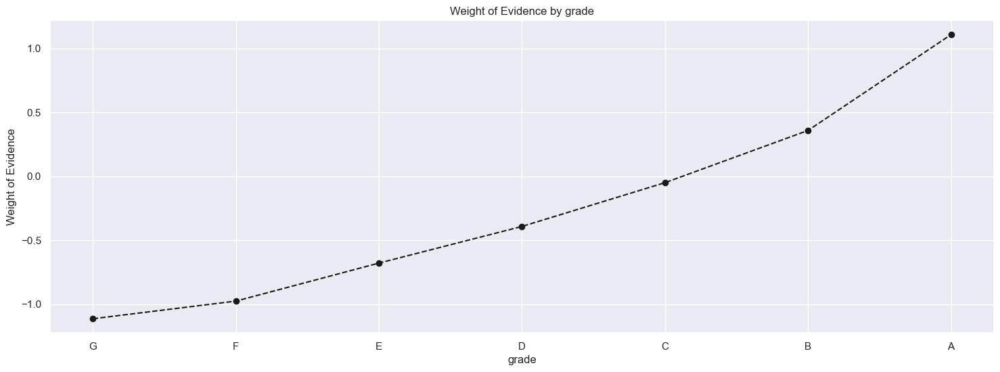

In [128]:
plot_by_woe(df_try)

In [131]:
df_temp, IV_temp = woe_discrete(x_train, 'home_ownership', y_train)
df_temp

,home_ownership,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
3,OTHER,137,0.795620,0.000367,109.0,28.0,0.000328,0.000687,-0.738602,NaN,NaN,0.000265
2,NONE,40,0.850000,0.000107,34.0,6.0,0.000102,0.000147,-0.363144,0.054380,0.375458,0.000016
5,RENT,150599,0.873870,0.403720,131604.0,18995.0,0.396099,0.465815,-0.162123,0.023870,0.201021,0.011303
4,OWN,33295,0.892536,0.089256,29717.0,3578.0,0.089442,0.087743,0.019170,0.018666,0.181294,0.000033
1,MORTGAGE,188956,0.903835,0.506546,170785.0,18171.0,0.514026,0.445608,0.142834,0.011298,0.123663,0.009772
0,ANY,1,1.000000,0.000003,1.0,0.0,0.000003,0.000000,inf,0.096165,inf,inf


IV Score: inf


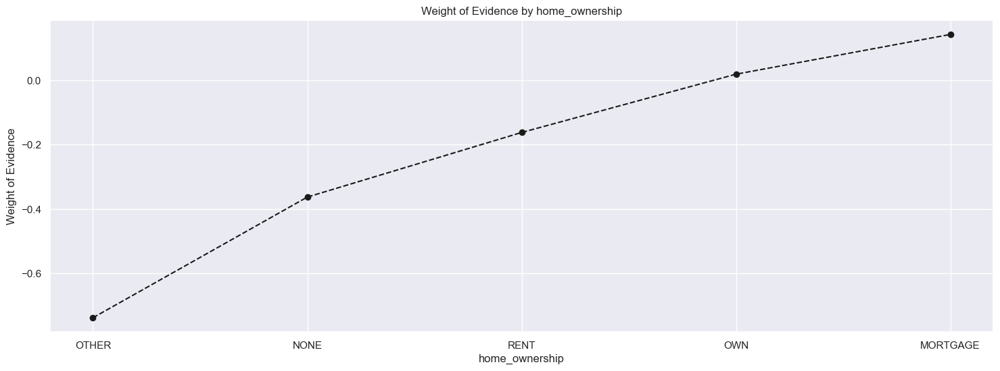

In [133]:
plot_by_woe(df_temp)
print(f"IV Score: {IV_temp}")

In [134]:
x_train['home_ownership:RENT_OTHER_NONE_ANY'] = sum([x_train['home_ownership:RENT'], x_train['home_ownership:OTHER'], x_train['home_ownership:NONE'], x_train['home_ownership:ANY']])

In [137]:
#for address_state:
x_train['addr_state'].unique()
df_addr_state, IV_addr_state = woe_discrete(x_train, 'addr_state', y_train)
df_addr_state

,addr_state,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
28,NE,13,0.461538,0.000035,6.0,7.0,0.000018,0.000172,-2.251896,NaN,NaN,3.458968e-04
12,IA,13,0.769231,0.000035,10.0,3.0,0.000030,0.000074,-0.893772,0.307692,1.358123,3.885341e-05
32,NV,5221,0.864585,0.013996,4514.0,707.0,0.013586,0.017338,-0.243837,0.095355,0.649935,9.147838e-04
9,FL,25211,0.875808,0.067585,22080.0,3131.0,0.066456,0.076782,-0.144425,0.011223,0.099411,1.491279e-03
11,HI,2001,0.877061,0.005364,1755.0,246.0,0.005282,0.006033,-0.132852,0.001253,0.011573,9.970539e-05
1,AL,4671,0.877328,0.012522,4098.0,573.0,0.012334,0.014052,-0.130376,0.000267,0.002476,2.239356e-04
31,NM,2075,0.883373,0.005563,1833.0,242.0,0.005517,0.005935,-0.072973,0.006045,0.057403,3.047682e-05
44,VA,11366,0.883864,0.030470,10046.0,1320.0,0.030236,0.032370,-0.068202,0.000491,0.004771,1.455522e-04
33,NY,32211,0.883984,0.086350,28474.0,3737.0,0.085701,0.091643,-0.067037,0.000120,0.001165,3.983340e-04
35,OK,3284,0.884287,0.008804,2904.0,380.0,0.008740,0.009319,-0.064072,0.000304,0.002965,3.705557e-05


IV Score for 'addr_state': inf


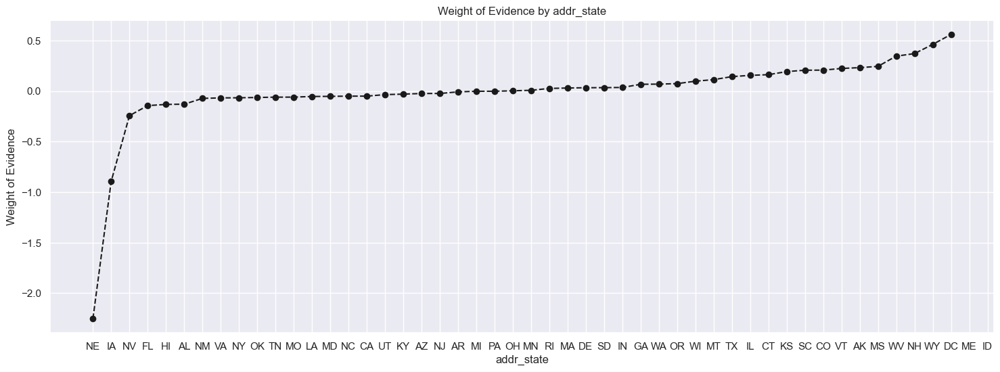

In [152]:
plot_by_woe(df_addr_state)
print(f"IV Score for 'addr_state': {IV_addr_state:.3f}")

In [139]:
#North Dakota not in df:
if ['addr_state:ND'] in x_train.columns.values:
    pass
else:
    x_train['addr_state:ND'] = 0

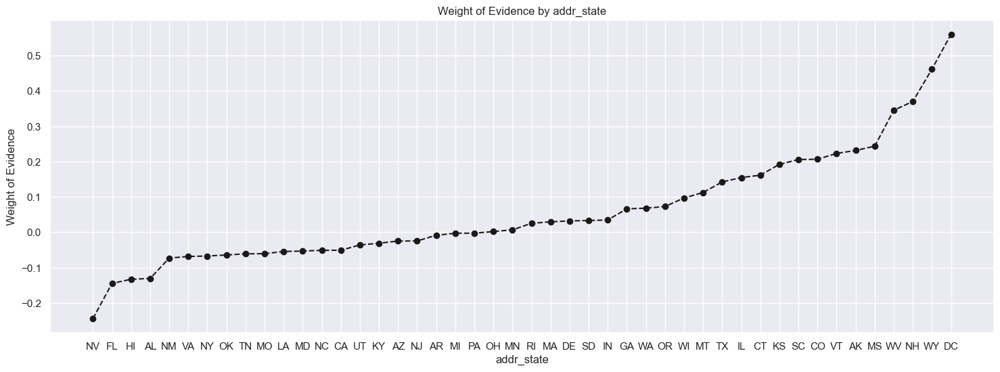

In [140]:
plot_by_woe(df_addr_state.iloc[2: -2, :])

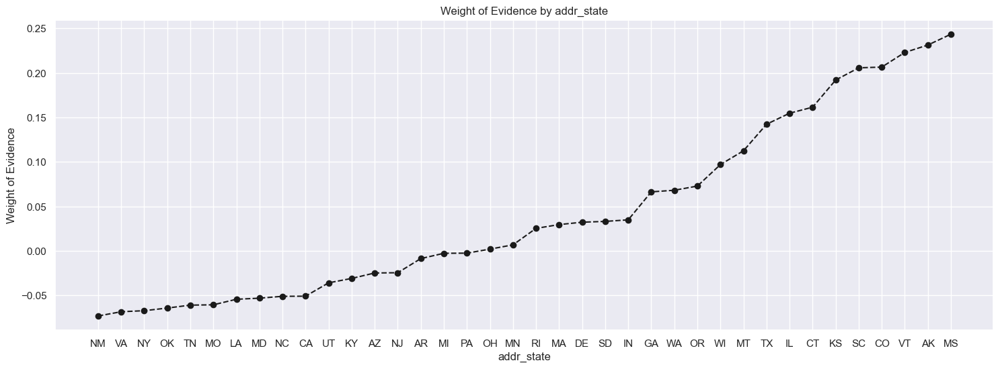

In [142]:
plot_by_woe(df_addr_state.iloc[6: -6, : ])

In [144]:
# We create the following categories:
# 'ND' 'NE' 'IA' NV' 'FL' 'HI' 'AL'
# 'NM' 'VA'
# 'NY'
# 'OK' 'TN' 'MO' 'LA' 'MD' 'NC'
# 'CA'
# 'UT' 'KY' 'AZ' 'NJ'
# 'AR' 'MI' 'PA' 'OH' 'MN'
# 'RI' 'MA' 'DE' 'SD' 'IN'
# 'GA' 'WA' 'OR'
# 'WI' 'MT'
# 'TX'
# 'IL' 'CT'
# 'KS' 'SC' 'CO' 'VT' 'AK' 'MS'
# 'WV' 'NH' 'WY' 'DC' 'ME' 'ID'

# 'IA_NV_HI_ID_AL_FL' will be the reference category.

x_train['addr_state:ND_NE_IA_NV_FL_HI_AL'] = sum([x_train['addr_state:ND'], x_train['addr_state:NE'],
                                              x_train['addr_state:IA'], x_train['addr_state:NV'],
                                              x_train['addr_state:FL'], x_train['addr_state:HI'],
                                                          x_train['addr_state:AL']])

x_train['addr_state:NM_VA'] = sum([x_train['addr_state:NM'], x_train['addr_state:VA']])

x_train['addr_state:OK_TN_MO_LA_MD_NC'] = sum([x_train['addr_state:OK'], x_train['addr_state:TN'],
                                              x_train['addr_state:MO'], x_train['addr_state:LA'],
                                              x_train['addr_state:MD'], x_train['addr_state:NC']])

x_train['addr_state:UT_KY_AZ_NJ'] = sum([x_train['addr_state:UT'], x_train['addr_state:KY'],
                                              x_train['addr_state:AZ'], x_train['addr_state:NJ']])

x_train['addr_state:AR_MI_PA_OH_MN'] = sum([x_train['addr_state:AR'], x_train['addr_state:MI'],
                                              x_train['addr_state:PA'], x_train['addr_state:OH'],
                                              x_train['addr_state:MN']])

x_train['addr_state:RI_MA_DE_SD_IN'] = sum([x_train['addr_state:RI'], x_train['addr_state:MA'],
                                              x_train['addr_state:DE'], x_train['addr_state:SD'],
                                              x_train['addr_state:IN']])

x_train['addr_state:GA_WA_OR'] = sum([x_train['addr_state:GA'], x_train['addr_state:WA'],
                                              x_train['addr_state:OR']])

x_train['addr_state:WI_MT'] = sum([x_train['addr_state:WI'], x_train['addr_state:MT']])

x_train['addr_state:IL_CT'] = sum([x_train['addr_state:IL'], x_train['addr_state:CT']])

x_train['addr_state:KS_SC_CO_VT_AK_MS'] = sum([x_train['addr_state:KS'], x_train['addr_state:SC'],
                                              x_train['addr_state:CO'], x_train['addr_state:VT'],
                                              x_train['addr_state:AK'], x_train['addr_state:MS']])

x_train['addr_state:WV_NH_WY_DC_ME_ID'] = sum([x_train['addr_state:WV'], x_train['addr_state:NH'],
                                              x_train['addr_state:WY'], x_train['addr_state:DC'],
                                              x_train['addr_state:ME'], x_train['addr_state:ID']])

In [146]:
#For: 'verification_status'
df_verification_status, IV_verification_status = woe_discrete(x_train, 'verification_status', y_train)
df_verification_status

,verification_status,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
2,Verified,134414,0.872781,0.360332,117314.0,17100.0,0.353090,0.419344,-0.171969,NaN,NaN,0.011394
1,Source Verified,120030,0.895918,0.321772,107537.0,12493.0,0.323663,0.306366,0.054922,0.023137,0.226891,0.000950
0,Not Verified,118584,0.905679,0.317896,107399.0,11185.0,0.323248,0.274290,0.164232,0.009761,0.109311,0.008040


IV Score for 'verfication status': 0.020


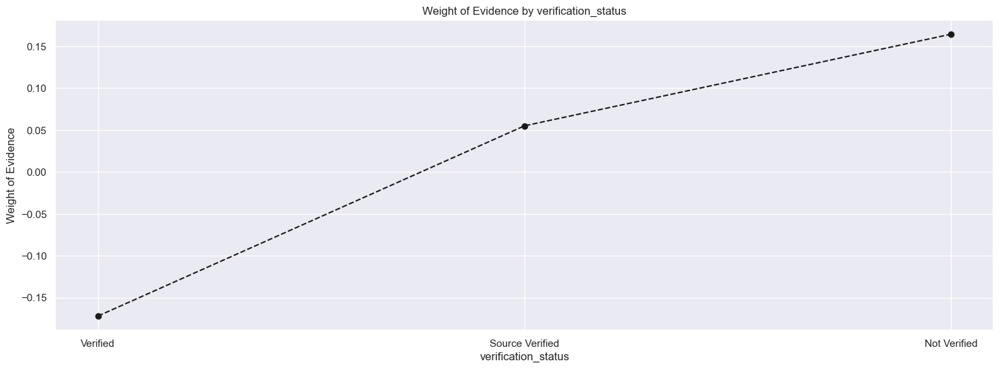

In [151]:
plot_by_woe(df_verification_status)
print(f"IV Score for 'verfication status': {IV_verification_status:.3f}")

In [153]:
#For: 'purpose'
df_purpose, IV_purpose = woe_discrete(x_train, 'purpose', y_train)
df_purpose

,purpose,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
11,small_business,5582,0.786098,0.014964,4388.0,1194.0,0.013207,0.029280,-0.796180,NaN,NaN,0.012797
3,educational,333,0.801802,0.000893,267.0,66.0,0.000804,0.001619,-0.700151,0.015704,0.096029,0.000571
8,moving,2392,0.839465,0.006412,2008.0,384.0,0.006044,0.009417,-0.443493,0.037663,0.256658,0.001496
5,house,1830,0.860109,0.004906,1574.0,256.0,0.004737,0.006278,-0.281547,0.020644,0.161946,0.000434
9,other,18884,0.862264,0.050624,16283.0,2601.0,0.049008,0.063784,-0.263519,0.002155,0.018028,0.003894
10,renewable_energy,281,0.864769,0.000753,243.0,38.0,0.000731,0.000932,-0.242270,0.002504,0.021250,0.000049
7,medical,3684,0.868350,0.009876,3199.0,485.0,0.009628,0.011894,-0.211300,0.003581,0.030969,0.000479
13,wedding,1887,0.881823,0.005059,1664.0,223.0,0.005008,0.005469,-0.087937,0.013473,0.123363,0.000040
12,vacation,1991,0.882471,0.005337,1757.0,234.0,0.005288,0.005738,-0.081703,0.000648,0.006234,0.000037
2,debt_consolidation,219183,0.886884,0.587578,194390.0,24793.0,0.585071,0.607999,-0.038440,0.004413,0.043263,0.000881


IV Score for 'purpose': 0.035


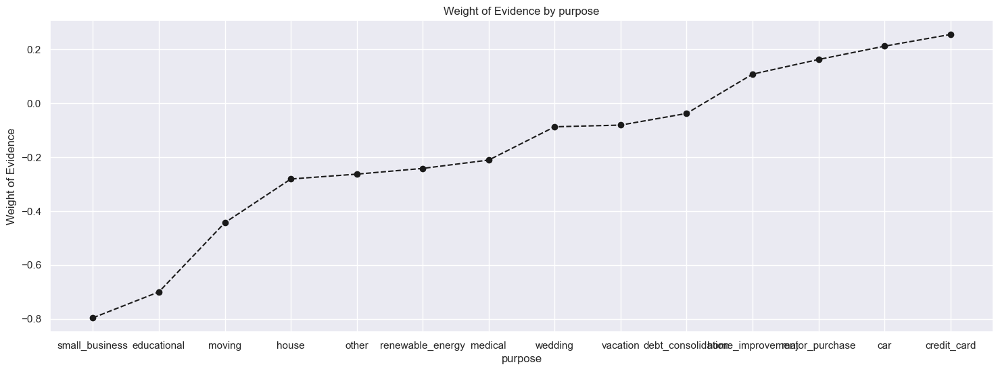

In [155]:
plot_by_woe(df_purpose)
print(f"IV Score for 'purpose': {IV_purpose:.3f}")

In [156]:
# We combine 'educational', 'small_business', 'wedding', 'renewable_energy', 'moving', 'house' in one category: 'educ__sm_b__wedd__ren_en__mov__house'.
# We combine 'other', 'medical', 'vacation' in one category: 'oth__med__vacation'.
# We combine 'major_purchase', 'car', 'home_improvement' in one category: 'major_purch__car__home_impr'.
# We leave 'debt_consolidtion' in a separate category.
# We leave 'credit_card' in a separate category.
# 'educ__sm_b__wedd__ren_en__mov__house' will be the reference category.
x_train['purpose:educ__sm_b__wedd__ren_en__mov__house'] = sum([x_train['purpose:educational'], x_train['purpose:small_business'],
                                                                 x_train['purpose:wedding'], x_train['purpose:renewable_energy'],
                                                                 x_train['purpose:moving'], x_train['purpose:house']])
x_train['purpose:oth__med__vacation'] = sum([x_train['purpose:other'], x_train['purpose:medical'],
                                             x_train['purpose:vacation']])
x_train['purpose:major_purch__car__home_impr'] = sum([x_train['purpose:major_purchase'], x_train['purpose:car'],
                                                        x_train['purpose:home_improvement']])

In [157]:
df_initial_list_status, IV_initial_list_status = woe_discrete(x_train, 'initial_list_status', y_train)
df_initial_list_status

,initial_list_status,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,f,242514,0.879694,0.650123,213338.0,29176.0,0.642101,0.715484,-0.108214,NaN,NaN,0.007941
1,w,130514,0.911105,0.349877,118912.0,11602.0,0.357899,0.284516,0.229461,0.031412,0.337675,0.016839


IV Score for 'initial_list_status': 0.025


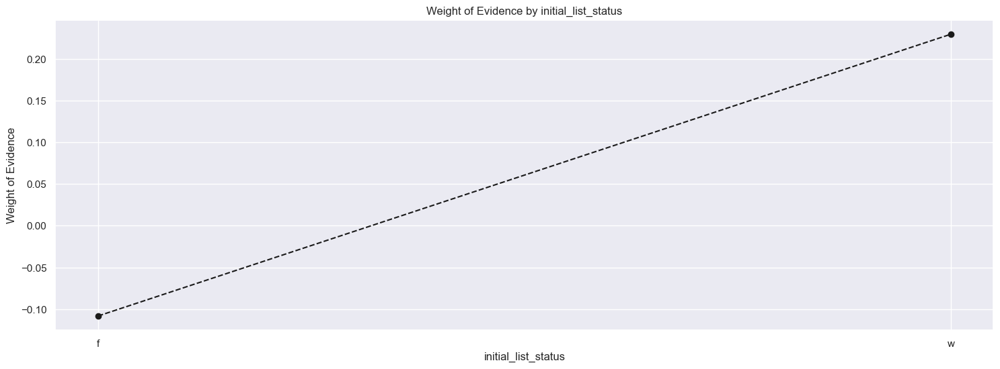

In [158]:
plot_by_woe(df_initial_list_status)
print(f"IV Score for 'initial_list_status': {IV_initial_list_status:.3f}")

In [159]:
#For continuous variables: split them into categories:
def woe_ordered_continuous(df, discrete_variable_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variable_name], good_bad_variable_df], axis=1)
    df.columns = [discrete_variable_name, 'good_bad']
    
    count_df = df.groupby(df.columns.values[0], as_index= False)[df.columns.values[1]].count()
    mean_df = df.groupby(df.columns.values[0], as_index= False)[df.columns.values[1]].mean()
    
    df = pd.concat([count_df, mean_df], axis=1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'num_obs', 'prop_good']
    
    df['prop_num_obs'] = df['num_obs'] / df['num_obs'].sum()
    df['n_good'] = df['prop_good'] * df['num_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['num_obs']
    
    df['prop_num_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_num_bad'] = df['n_bad'] / df['n_bad'].sum()
    
    df['WoE'] = np.log(df['prop_num_good'] / df['prop_num_bad'])
    
    # df = df.sort_values(['WoE'])
    # df.reset_index(drop=True)
    
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    
    df['IV'] = (df['prop_num_good'] - df['prop_num_bad']) * df['WoE']
    IV = df['IV'].sum()
    
    return df, IV

In [160]:
x_train['term_int'].unique()

array([36., 60.])

In [161]:
df_term_int, IV_term_int = woe_ordered_continuous(x_train, 'term_int', y_train)
df_term_int

,term_int,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,36.0,270419,0.902995,0.724929,244187.0,26232.0,0.73495,0.643288,0.133209,NaN,NaN,0.012210
1,60.0,102609,0.858239,0.275071,88063.0,14546.0,0.26505,0.356712,-0.297009,0.044756,0.430218,0.027224


IV Score for 'term_int': 0.039


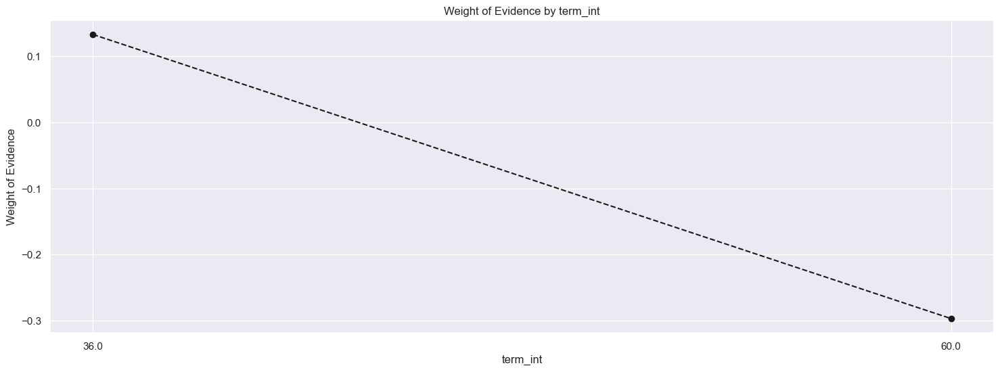

In [163]:
plot_by_woe(df_term_int)
print(f"IV Score for 'term_int': {IV_term_int:.3f}")

#60 month loans are much riskier than 30 month loans

In [164]:
#Creating dummy variables using np.where:
x_train['term:36'] = np.where((x_train['term_int'] == 36), 1, 0)
x_train['term:60'] = np.where((x_train['term_int'] == 60), 1, 0)

In [166]:
x_train['emp_length_int'].unique()

array([ 3.,  6., 10.,  7.,  5.,  1.,  2.,  9.,  8.,  0.,  4.])

In [167]:
df_emp_length_int, IV_emp_length_int = woe_ordered_continuous(x_train, 'emp_length_int', y_train)
df_emp_length_int

,emp_length_int,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,16808,0.868218,0.045058,14593.0,2215.0,0.043922,0.054319,-0.212455,NaN,NaN,2.208848e-03
1,1.0,52566,0.883784,0.140917,46457.0,6109.0,0.139825,0.149811,-0.068981,0.015567,0.143475,6.888255e-04
2,2.0,33078,0.890955,0.088674,29471.0,3607.0,0.088701,0.088455,0.002785,0.007171,0.071766,6.872024e-07
3,3.0,29205,0.890772,0.078292,26015.0,3190.0,0.078299,0.078228,0.000907,0.000183,0.001878,6.444066e-08
4,4.0,22468,0.890644,0.060231,20011.0,2457.0,0.060229,0.060253,-0.000404,0.000128,0.001311,9.829773e-09
5,5.0,24602,0.884725,0.065952,21766.0,2836.0,0.065511,0.069547,-0.059790,0.005920,0.059387,2.413379e-04
6,6.0,20887,0.883899,0.055993,18462.0,2425.0,0.055567,0.059468,-0.067862,0.000826,0.008071,2.647803e-04
7,7.0,21049,0.887453,0.056427,18680.0,2369.0,0.056223,0.058095,-0.032759,0.003554,0.035102,6.133645e-05
8,8.0,17853,0.889878,0.047860,15887.0,1966.0,0.047816,0.048212,-0.008245,0.002425,0.024515,3.263866e-06
9,9.0,14267,0.886662,0.038246,12650.0,1617.0,0.038074,0.039654,-0.040660,0.003217,0.032416,6.424315e-05


IV Score for 'emp_length_int': 0.007


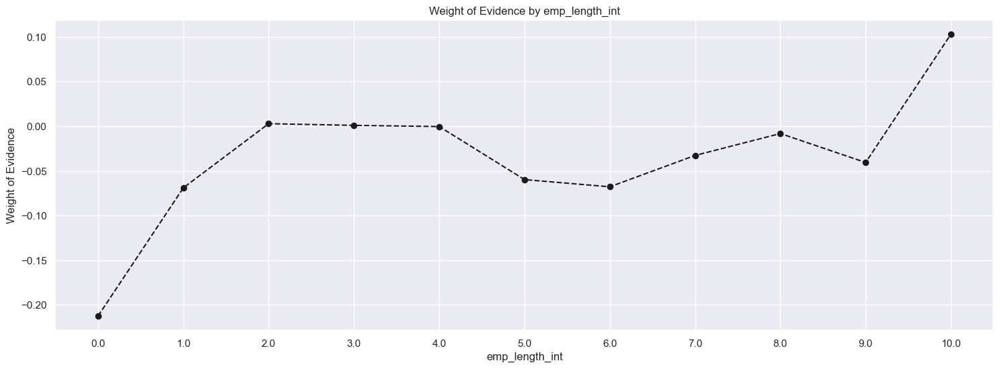

In [171]:
plot_by_woe(df_emp_length_int)
print(f"IV Score for 'emp_length_int': {IV_emp_length_int:.3f}")

# 0 months is the riskiest

In [172]:
#Splitting into categorical

x_train['emp_length:O'] = np.where(x_train['emp_length_int'].isin([0]), 1, 0)
x_train['emp_length:1'] = np.where(x_train['emp_length_int'].isin([1]), 1, 0)
x_train['emp_length:2-4'] = np.where(x_train['emp_length_int'].isin(range(2,5)), 1, 0)
x_train['emp_length:5-6'] = np.where(x_train['emp_length_int'].isin(range(5,7)), 1, 0)
x_train['emp_length:7-9'] = np.where(x_train['emp_length_int'].isin(range(7,10)), 1, 0)
x_train['emp_length:10'] = np.where(x_train['emp_length_int'].isin([10]), 1, 0)

In [173]:
x_train['mths_since_issue_d'].unique()

array([ 45.,  64.,  54.,  44., 101.,  37.,  91.,  53.,  42.,  57.,  58.,
        43.,  40.,  51.,  59., 113.,  50.,  62.,  49.,  47.,  48.,  41.,
        38.,  66.,  69.,  87.,  46.,  76.,  63.,  39.,  61.,  89.,  65.,
        56.,  79.,  68.,  52.,  60.,  73.,  74.,  70.,  88.,  81.,  82.,
        55., 103.,  83.,  72.,  85.,  36.,  71.,  92.,  77.,  67.,  84.,
        86.,  90., 116.,  93.,  95.,  78.,  75.,  80.,  96.,  94.,  98.,
       104., 125., 105., 118., 110., 119., 114.,  97., 102., 106., 100.,
       122., 121., 108., 117., 120., 124.,  99., 115., 112., 109., 123.,
       107., 126., 111.])

### Classing Explanation:
- **Fine Classing:** This stage involves the initial grouping of values into specific categories, aiming for a more detailed breakdown of the data.
- **Coarse Classing:** In this phase, the final categories are determined by combining some of the previously established fine classing categories into broader groups, whenever necessary for a clearer representation.


In [174]:
# Fine Classing
# Using pandas cut function to make independant variables into intervals:
x_train['mths_since_issue_d_factor'] = pd.cut(x_train['mths_since_issue_d'], 50)
x_train['mths_since_issue_d_factor']

427211      (43.2, 45.0]
206088      (63.0, 64.8]
136020      (52.2, 54.0]
412305      (43.2, 45.0]
36159     (100.8, 102.6]
260400     (35.91, 37.8]
29626       (90.0, 91.8]
117003      (52.2, 54.0]
378696      (41.4, 43.2]
159555      (55.8, 57.6]
258931     (35.91, 37.8]
435023      (43.2, 45.0]
434939      (43.2, 45.0]
166714      (57.6, 59.4]
397514      (41.4, 43.2]
412695      (43.2, 45.0]
326791      (39.6, 41.4]
399112      (41.4, 43.2]
386208      (41.4, 43.2]
90207       (50.4, 52.2]
177298      (57.6, 59.4]
41491     (111.6, 113.4]
84297       (48.6, 50.4]
193825      (61.2, 63.0]
391693      (41.4, 43.2]
431675      (43.2, 45.0]
66434       (48.6, 50.4]
454638      (46.8, 48.6]
89746       (50.4, 52.2]
50163       (46.8, 48.6]
367344      (41.4, 43.2]
349219      (39.6, 41.4]
346074      (39.6, 41.4]
290389      (37.8, 39.6]
214844      (64.8, 66.6]
222888      (68.4, 70.2]
122435      (52.2, 54.0]
465903      (46.8, 48.6]
390024      (41.4, 43.2]
377139      (41.4, 43.2]


In [176]:
df_mths_since_issue_d_factor, IV_mths_since_issue_d_factor = woe_ordered_continuous(x_train, 'mths_since_issue_d_factor', y_train)
df_mths_since_issue_d_factor

,mths_since_issue_d_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(35.91, 37.8]",28170,0.942244,0.075517,26543.0,1627.0,0.079889,0.039899,0.694283,NaN,NaN,2.776416e-02
1,"(37.8, 39.6]",39636,0.928424,0.106255,36799.0,2837.0,0.110757,0.069572,0.464979,0.013820,0.229305,1.915020e-02
2,"(39.6, 41.4]",38614,0.917284,0.103515,35420.0,3194.0,0.106606,0.078327,0.308258,0.011140,0.156721,8.717501e-03
3,"(41.4, 43.2]",29038,0.908603,0.077844,26384.0,2654.0,0.079410,0.065084,0.198945,0.008681,0.109313,2.850078e-03
4,"(43.2, 45.0]",28367,0.901787,0.076045,25581.0,2786.0,0.076993,0.068321,0.119498,0.006815,0.079447,1.036296e-03
5,"(45.0, 46.8]",12165,0.899301,0.032611,10940.0,1225.0,0.032927,0.030041,0.091740,0.002486,0.027758,2.647895e-04
6,"(46.8, 48.6]",24451,0.898900,0.065547,21979.0,2472.0,0.066152,0.060621,0.087315,0.000401,0.004425,4.829451e-04
7,"(48.6, 50.4]",22969,0.888328,0.061574,20404.0,2565.0,0.061412,0.062902,-0.023972,0.010572,0.111287,3.571847e-05
8,"(50.4, 52.2]",20640,0.880523,0.055331,18174.0,2466.0,0.054700,0.060474,-0.100350,0.007804,0.076378,5.794242e-04
9,"(52.2, 54.0]",18312,0.866863,0.049090,15874.0,2438.0,0.047777,0.059787,-0.224240,0.013660,0.123890,2.693097e-03


IV Score for 'mths_since_issue_d_factor': 0.113


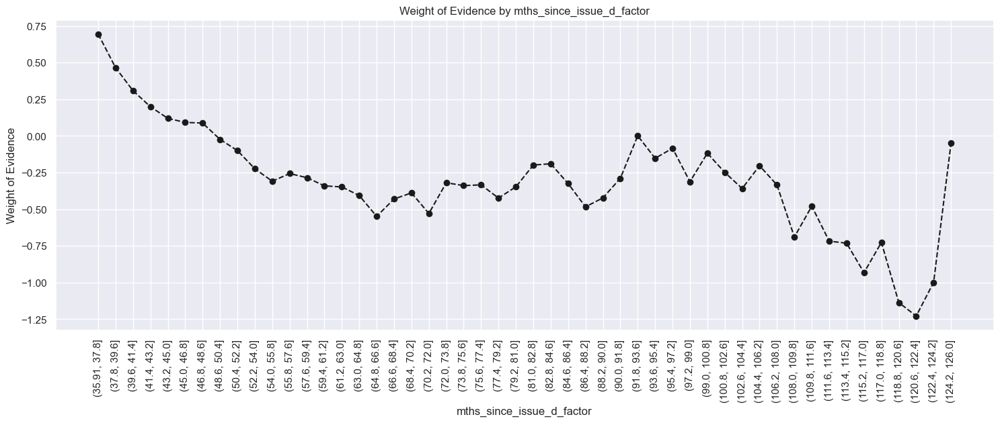

In [177]:
plot_by_woe(df_mths_since_issue_d_factor, rotation_of_x_axis_labels=90)
print(f"IV Score for 'mths_since_issue_d_factor': {IV_mths_since_issue_d_factor:.3f}")

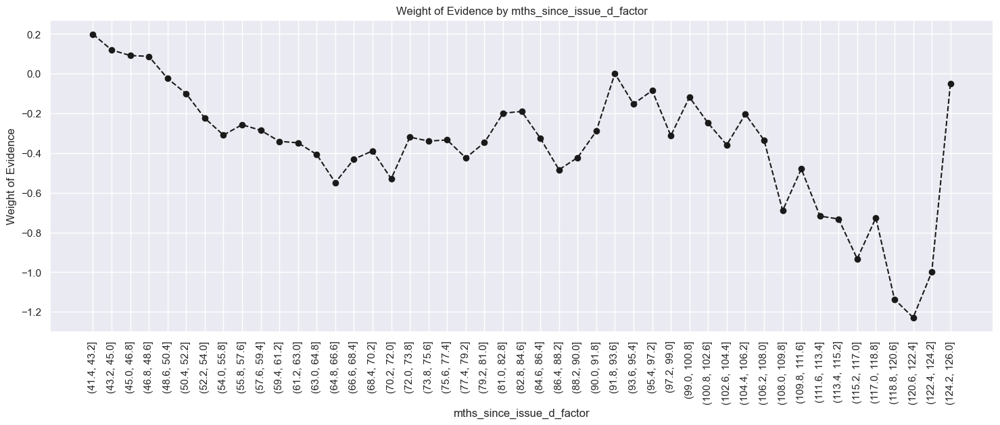

In [178]:
plot_by_woe(df_mths_since_issue_d_factor.iloc[3: , : ], rotation_of_x_axis_labels=90)

In [181]:
#Splitting into categorical:

x_train['mths_since_issue_d:<38'] = np.where(x_train['mths_since_issue_d'].isin(range(38)), 1, 0)
x_train['mths_since_issue_d:38-39'] = np.where(x_train['mths_since_issue_d'].isin(range(38, 40)), 1, 0)
x_train['mths_since_issue_d:40-41'] = np.where(x_train['mths_since_issue_d'].isin(range(40, 42)), 1, 0)
x_train['mths_since_issue_d:42-48'] = np.where(x_train['mths_since_issue_d'].isin(range(42, 49)), 1, 0)
x_train['mths_since_issue_d:49-52'] = np.where(x_train['mths_since_issue_d'].isin(range(49, 53)), 1, 0)
x_train['mths_since_issue_d:53-64'] = np.where(x_train['mths_since_issue_d'].isin(range(53, 65)), 1, 0)
x_train['mths_since_issue_d:65-84'] = np.where(x_train['mths_since_issue_d'].isin(range(65, 85)), 1, 0)
x_train['mths_since_issue_d:>84'] = np.where(x_train['mths_since_issue_d'].isin(range(85, int(x_train['mths_since_issue_d'].max()))), 1, 0)

In [182]:
#Fine class 'interest_rate':
x_train['int_rate_factor'] = pd.cut(x_train['int_rate'], 50)

df_int_rate, IV_int_rate = woe_ordered_continuous(x_train, 'int_rate_factor', y_train)
df_int_rate

,int_rate_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(5.399, 5.833]",785,0.961783,0.002104,755.0,30.0,0.002272,0.000736,1.127775,NaN,NaN,0.001733
1,"(5.833, 6.246]",8459,0.980376,0.022677,8293.0,166.0,0.024960,0.004071,1.813434,0.018592,0.685659,0.037881
2,"(6.246, 6.658]",7826,0.971505,0.020980,7603.0,223.0,0.022883,0.005469,1.431381,0.008871,0.382053,0.024927
3,"(6.658, 7.071]",1816,0.973018,0.004868,1767.0,49.0,0.005318,0.001202,1.487473,0.001512,0.056092,0.006123
4,"(7.071, 7.484]",3143,0.976456,0.008426,3069.0,74.0,0.009237,0.001815,1.627297,0.003438,0.139824,0.012078
5,"(7.484, 7.897]",12581,0.962324,0.033727,12107.0,474.0,0.036439,0.011624,1.142587,0.014131,0.484710,0.028354
6,"(7.897, 8.31]",9687,0.949314,0.025969,9196.0,491.0,0.027678,0.012041,0.832335,0.013011,0.310252,0.013015
7,"(8.31, 8.722]",6594,0.965271,0.017677,6365.0,229.0,0.019157,0.005616,1.227103,0.015958,0.394768,0.016617
8,"(8.722, 9.135]",9539,0.937415,0.025572,8942.0,597.0,0.026913,0.014640,0.608852,0.027857,0.618250,0.007473
9,"(9.135, 9.548]",6681,0.963928,0.017910,6440.0,241.0,0.019383,0.005910,1.187742,0.026513,0.578889,0.016002


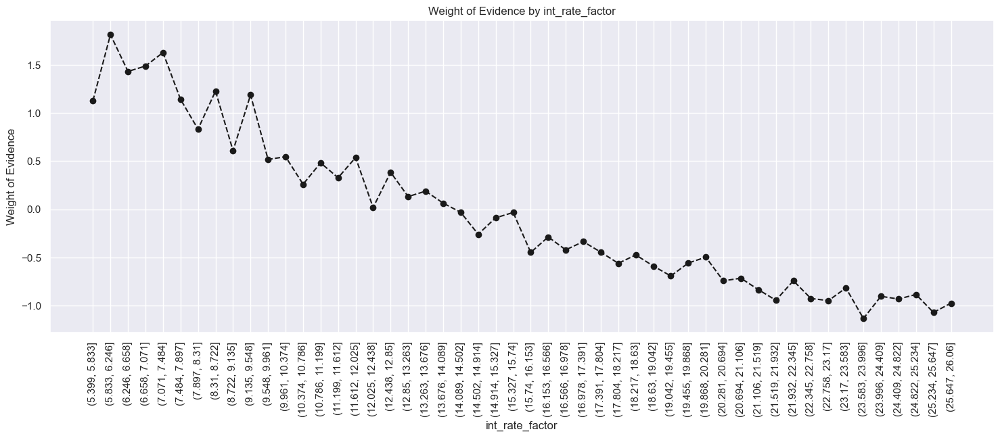

In [183]:
plot_by_woe(df_int_rate, 90)

#The greater the interest rate the lower the weight of evidence

In [184]:
#Creating into 5 dummies:

x_train['int_rate:<9.548'] = np.where((x_train['int_rate'] <= 9.548), 1, 0)
x_train['int_rate:9.548-12.025'] = np.where((x_train['int_rate'] > 9.548) & (x_train['int_rate'] <= 12.025), 1, 0)
x_train['int_rate:12.025-15.74'] = np.where((x_train['int_rate'] > 12.025) & (x_train['int_rate'] <= 15.74), 1, 0)
x_train['int_rate:15.74-20.281'] = np.where((x_train['int_rate'] > 15.74) & (x_train['int_rate'] <= 20.281), 1, 0)
x_train['int_rate:>20.281'] = np.where((x_train['int_rate'] <= 20.281), 1, 0)

In [185]:
x_train['funded_amnt_factor'] = pd.cut(x_train['funded_amnt'], 50)

df_funded_amnt, IV_funded_amnt = woe_ordered_continuous(x_train, 'funded_amnt_factor', y_train)
df_funded_amnt

,funded_amnt_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(465.5, 1190.0]",1224,0.905229,0.003281,1108.0,116.0,0.003335,0.002845,0.158977,NaN,NaN,7.792514e-05
1,"(1190.0, 1880.0]",3028,0.903897,0.008117,2737.0,291.0,0.008238,0.007136,0.143549,0.001332,0.015427,1.581301e-04
2,"(1880.0, 2570.0]",6018,0.893819,0.016133,5379.0,639.0,0.016190,0.015670,0.032608,0.010078,0.110941,1.693683e-05
3,"(2570.0, 3260.0]",7248,0.889073,0.019430,6444.0,804.0,0.019395,0.019717,-0.016440,0.004746,0.049048,5.284970e-06
4,"(3260.0, 3950.0]",4751,0.891602,0.012736,4236.0,515.0,0.012749,0.012629,0.009463,0.002529,0.025902,1.136265e-06
5,"(3950.0, 4640.0]",9023,0.890945,0.024189,8039.0,984.0,0.024196,0.024131,0.002689,0.000656,0.006774,1.747301e-07
6,"(4640.0, 5330.0]",15903,0.892159,0.042632,14188.0,1715.0,0.042703,0.042057,0.015238,0.001213,0.012549,9.840896e-06
7,"(5330.0, 6020.0]",17236,0.906069,0.046206,15617.0,1619.0,0.047004,0.039703,0.168806,0.013910,0.153568,1.232452e-03
8,"(6020.0, 6710.0]",6914,0.887619,0.018535,6137.0,777.0,0.018471,0.019054,-0.031094,0.018449,0.199900,1.813905e-05
9,"(6710.0, 7400.0]",11806,0.898018,0.031649,10602.0,1204.0,0.031910,0.029526,0.077648,0.010399,0.108742,1.851122e-04


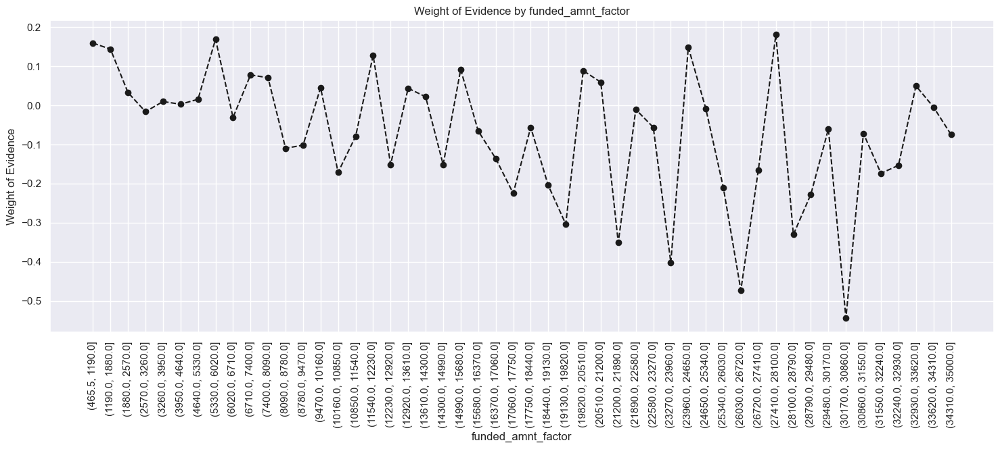

In [186]:
plot_by_woe(df_funded_amnt, 90)

#There is no association whatsoever between the 'finded amnt' and the WoE:

In [188]:
#Fine class 'mths_since_earliest_cr_line':
x_train['mths_since_earliest_cr_line_factor'] = pd.cut(x_train['mths_since_earliest_cr_line'], 50)
df_mths_since_earliest_cr_line, IV_mths_since_earliest_cr_line = woe_ordered_continuous(x_train, 'mths_since_earliest_cr_line_factor', y_train)
df_mths_since_earliest_cr_line

,mths_since_earliest_cr_line_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.587, 11.74]",24,0.875000,0.000064,21.0,3.0,0.000063,0.000074,-0.151835,NaN,NaN,1.573565e-06
1,"(11.74, 23.48]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"(23.48, 35.22]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"(35.22, 46.96]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"(46.96, 58.7]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,"(58.7, 70.44]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,"(70.44, 82.18]",722,0.898892,0.001936,649.0,73.0,0.001953,0.001790,0.087228,NaN,NaN,1.423281e-05
7,"(82.18, 93.92]",1929,0.884914,0.005171,1707.0,222.0,0.005138,0.005444,-0.057930,0.013978,0.145158,1.775048e-05
8,"(93.92, 105.66]",2817,0.857295,0.007552,2415.0,402.0,0.007269,0.009858,-0.304742,0.027619,0.246813,7.891715e-04
9,"(105.66, 117.4]",5092,0.871170,0.013650,4436.0,656.0,0.013351,0.016087,-0.186397,0.013875,0.118345,5.099300e-04


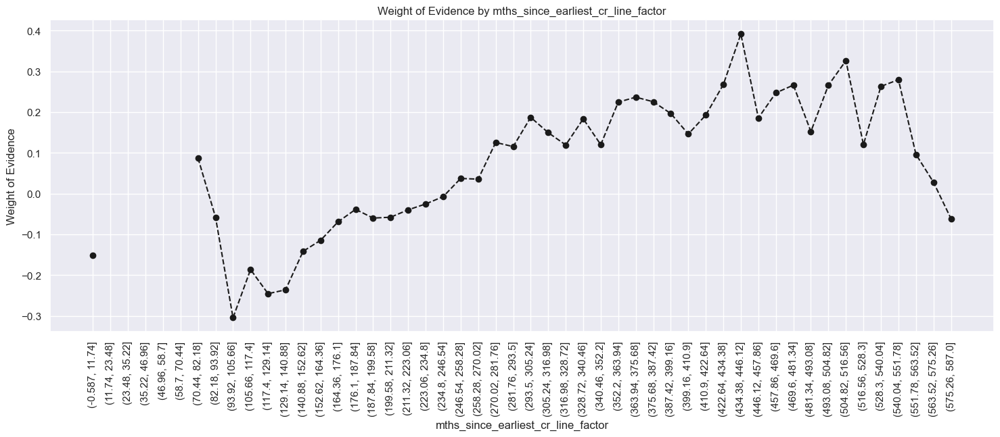

In [189]:
plot_by_woe(df_mths_since_earliest_cr_line, 90)

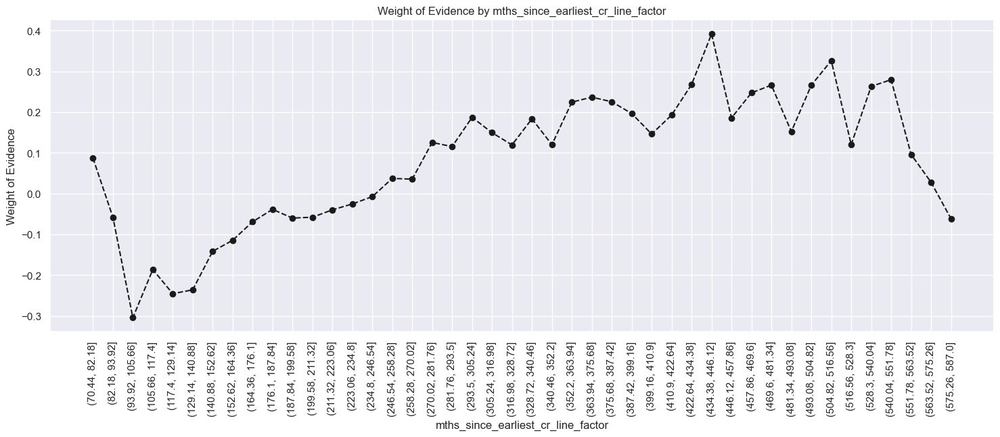

In [190]:
plot_by_woe(df_mths_since_earliest_cr_line.iloc[6: , : ], 90)

In [191]:
#Splitting into categorical:
# < 140, # 141 - 164, # 165 - 247, # 248 - 270, # 271 - 352, # > 352
x_train['mths_since_earliest_cr_line:<140'] = np.where(x_train['mths_since_earliest_cr_line'].isin(range(140)), 1, 0)
x_train['mths_since_earliest_cr_line:141-164'] = np.where(x_train['mths_since_earliest_cr_line'].isin(range(140, 165)), 1, 0)
x_train['mths_since_earliest_cr_line:165-247'] = np.where(x_train['mths_since_earliest_cr_line'].isin(range(165, 248)), 1, 0)
x_train['mths_since_earliest_cr_line:248-270'] = np.where(x_train['mths_since_earliest_cr_line'].isin(range(248, 271)), 1, 0)
x_train['mths_since_earliest_cr_line:271-352'] = np.where(x_train['mths_since_earliest_cr_line'].isin(range(271, 353)), 1, 0)
x_train['mths_since_earliest_cr_line:>352'] = np.where(x_train['mths_since_earliest_cr_line'].isin(range(353, int(x_train['mths_since_earliest_cr_line'].max()))), 1, 0)

In [192]:
# For: delinq_2yrs
df_delinq_2yrs, IV_delinq_2yrs = woe_ordered_continuous(x_train, 'delinq_2yrs', y_train)
df_delinq_2yrs

,delinq_2yrs,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,306417,0.890499,0.821432,272864.0,33553.0,0.821261,0.822821,-0.001898,NaN,NaN,2.960552e-06
1,1.0,44927,0.893249,0.120439,40131.0,4796.0,0.120786,0.117612,0.026622,0.002750,0.028520,8.447431e-05
2,2.0,13118,0.889007,0.035166,11662.0,1456.0,0.035100,0.035706,-0.017102,0.004242,0.043724,1.035459e-05
3,3.0,4550,0.883297,0.012197,4019.0,531.0,0.012096,0.013022,-0.073719,0.005711,0.056616,6.822026e-05
4,4.0,1868,0.898822,0.005008,1679.0,189.0,0.005053,0.004635,0.086462,0.015526,0.160180,3.619039e-05
5,5.0,966,0.881988,0.002590,852.0,114.0,0.002564,0.002796,-0.086357,0.016835,0.172819,1.997357e-05
6,6.0,501,0.902196,0.001343,452.0,49.0,0.001360,0.001202,0.124117,0.020208,0.210474,1.970890e-05
7,7.0,279,0.860215,0.000748,240.0,39.0,0.000722,0.000956,-0.280668,0.041981,0.404785,6.569040e-05
8,8.0,148,0.905405,0.000397,134.0,14.0,0.000403,0.000343,0.161037,0.045190,0.441705,9.660378e-06
9,9.0,89,0.887640,0.000239,79.0,10.0,0.000238,0.000245,-0.030882,0.017765,0.191920,2.303044e-07


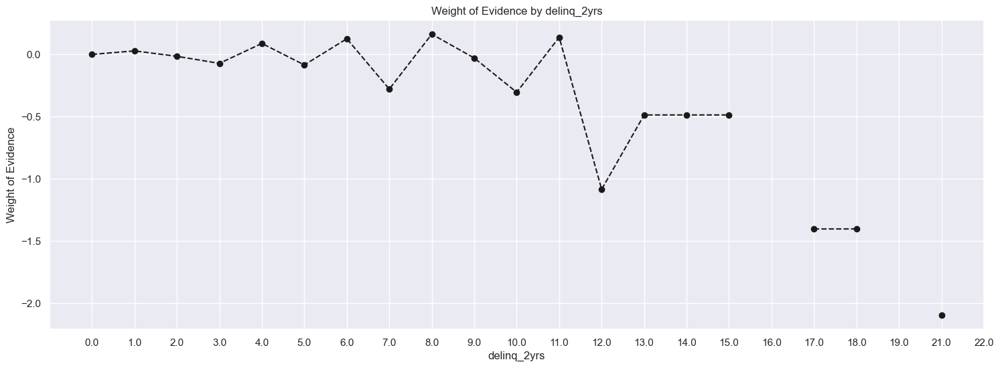

In [193]:
plot_by_woe(df_delinq_2yrs)

In [194]:
#Split into categorical:

# Categories: 0, 1 - 2, 3 - 6, > 6
x_train['inq_last_6mths:0'] = np.where((x_train['inq_last_6mths'] == 0), 1, 0)
x_train['inq_last_6mths:1-2'] = np.where((x_train['inq_last_6mths'] >= 1) & (x_train['inq_last_6mths'] <= 2), 1, 0)
x_train['inq_last_6mths:3-6'] = np.where((x_train['inq_last_6mths'] >= 3) & (x_train['inq_last_6mths'] <= 6), 1, 0)
x_train['inq_last_6mths:>6'] = np.where((x_train['inq_last_6mths'] > 6), 1, 0)

In [195]:
# For: open_acc
df_open_acc, IV_open_acc = woe_ordered_continuous(x_train, 'open_acc', y_train)
df_open_acc

/Users/mckishiebombom/.pyenv/versions/3.10.6/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,open_acc,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,29,0.758621,0.000078,22.0,7.0,0.000066,0.000172,-0.952613,NaN,NaN,1.004492e-04
1,1.0,110,0.872727,0.000295,96.0,14.0,0.000289,0.000343,-0.172454,0.114107,0.780159,9.378629e-06
2,2.0,1456,0.845467,0.003903,1231.0,225.0,0.003705,0.005518,-0.398263,0.027260,0.225809,7.219078e-04
3,3.0,4378,0.873687,0.011736,3825.0,553.0,0.011512,0.013561,-0.163789,0.028220,0.234474,3.355744e-04
4,4.0,10028,0.891504,0.026883,8940.0,1088.0,0.026907,0.026681,0.008449,0.017817,0.172239,1.912922e-06
5,5.0,17141,0.891255,0.045951,15277.0,1864.0,0.045980,0.045711,0.005879,0.000249,0.002571,1.584401e-06
6,6.0,24621,0.892368,0.066003,21971.0,2650.0,0.066128,0.064986,0.017419,0.001113,0.011540,1.989040e-05
7,7.0,30169,0.891544,0.080876,26897.0,3272.0,0.080954,0.080239,0.008868,0.000824,0.008550,6.338714e-06
8,8.0,33579,0.891033,0.090017,29920.0,3659.0,0.090053,0.089730,0.003592,0.000511,0.005276,1.160004e-06
9,9.0,35251,0.889195,0.094500,31345.0,3906.0,0.094342,0.095787,-0.015204,0.001838,0.018796,2.197492e-05


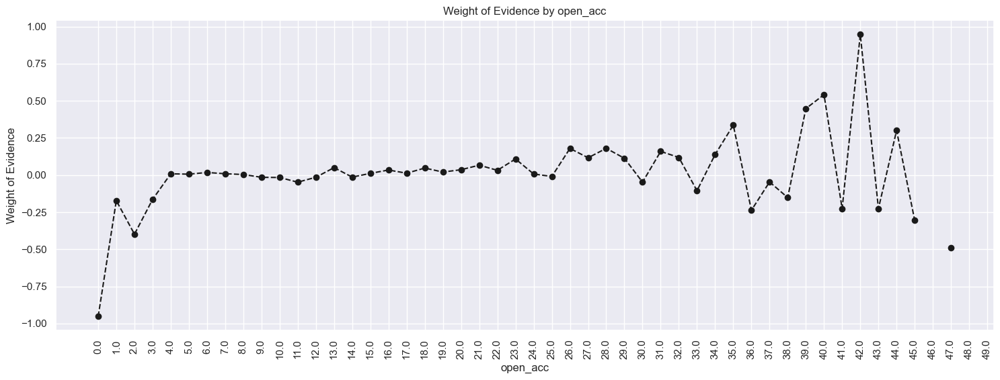

In [196]:
plot_by_woe(df_open_acc, 90)

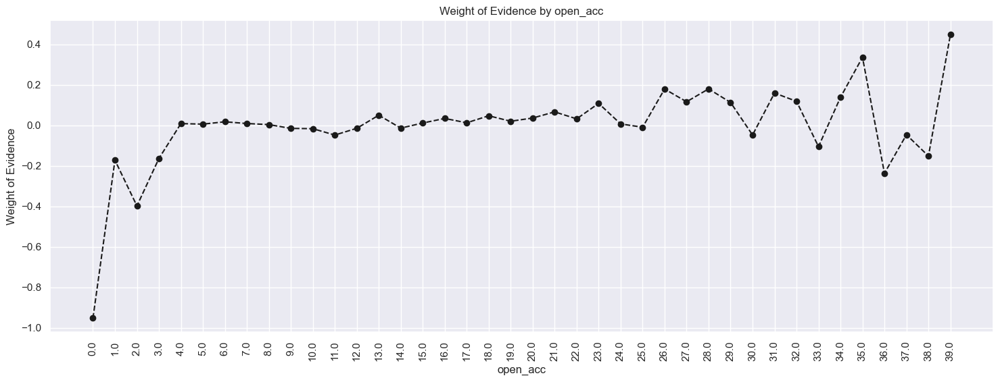

In [197]:
plot_by_woe(df_open_acc.iloc[ : 40, :], 90)

In [198]:
#Split into categorical:
# Categories: '0', '1-3', '4-12', '13-17', '18-22', '23-25', '26-30', '>30'
x_train['open_acc:0'] = np.where((x_train['open_acc'] == 0), 1, 0)
x_train['open_acc:1-3'] = np.where((x_train['open_acc'] >= 1) & (x_train['open_acc'] <= 3), 1, 0)
x_train['open_acc:4-12'] = np.where((x_train['open_acc'] >= 4) & (x_train['open_acc'] <= 12), 1, 0)
x_train['open_acc:13-17'] = np.where((x_train['open_acc'] >= 13) & (x_train['open_acc'] <= 17), 1, 0)
x_train['open_acc:18-22'] = np.where((x_train['open_acc'] >= 18) & (x_train['open_acc'] <= 22), 1, 0)
x_train['open_acc:23-25'] = np.where((x_train['open_acc'] >= 23) & (x_train['open_acc'] <= 25), 1, 0)
x_train['open_acc:26-30'] = np.where((x_train['open_acc'] >= 26) & (x_train['open_acc'] <= 30), 1, 0)
x_train['open_acc:>=31'] = np.where((x_train['open_acc'] >= 31), 1, 0)

In [199]:
#For: pub_rec:
df_pub_rec, IV_pub_rec= woe_ordered_continuous(x_train, 'pub_rec', y_train)
df_pub_rec

,pub_rec,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,323999,0.889941,0.868565,288340.0,35659.0,0.867840,0.874467,-0.007606,NaN,NaN,0.000050
1,1.0,42381,0.893419,0.113613,37864.0,4517.0,0.113962,0.110771,0.028408,0.003478,0.036014,0.000091
2,2.0,4527,0.903247,0.012136,4089.0,438.0,0.012307,0.010741,0.136092,0.009828,0.107684,0.000213
3,3.0,1280,0.920312,0.003431,1178.0,102.0,0.003546,0.002501,0.348856,0.017065,0.212764,0.000364
4,4.0,408,0.924020,0.001094,377.0,31.0,0.001135,0.000760,0.400513,0.003707,0.051657,0.000150
5,5.0,203,0.911330,0.000544,185.0,18.0,0.000557,0.000441,0.232239,0.012690,0.168274,0.000027
6,6.0,117,0.931624,0.000314,109.0,8.0,0.000328,0.000196,0.514161,0.020294,0.281922,0.000068
7,7.0,48,0.958333,0.000129,46.0,2.0,0.000138,0.000049,1.037749,0.026709,0.523588,0.000093
8,8.0,24,1.000000,0.000064,24.0,0.0,0.000072,0.000000,inf,0.041667,inf,inf
9,9.0,14,0.785714,0.000038,11.0,3.0,0.000033,0.000074,-0.798462,0.214286,inf,0.000032


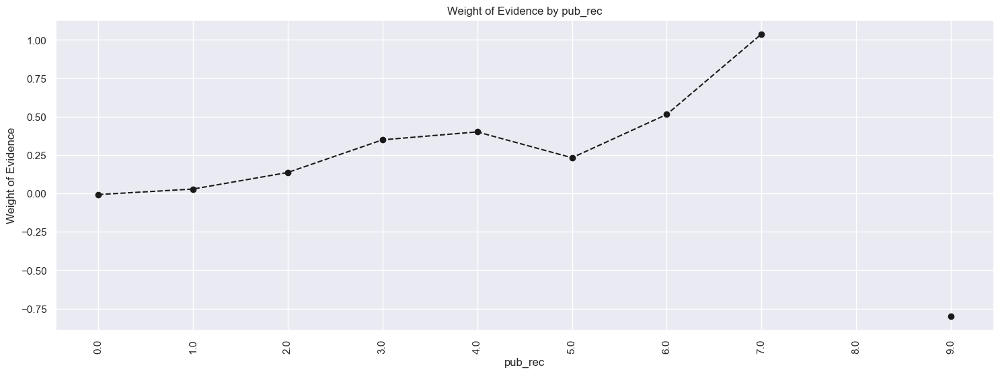

In [200]:
plot_by_woe(df_pub_rec, 90)

In [202]:
#Split into categorical:

# Categories '0-2', '3-4', '>=5'
x_train['pub_rec:0-2'] = np.where((x_train['pub_rec'] >= 0) & (x_train['pub_rec'] <= 2), 1, 0)
x_train['pub_rec:3-4'] = np.where((x_train['pub_rec'] >= 3) & (x_train['pub_rec'] <= 4), 1, 0)
x_train['pub_rec:>=5'] = np.where((x_train['pub_rec'] >= 5), 1, 0)

In [203]:
#For total_acc:
x_train['total_acc_factor'] = pd.cut(x_train['total_acc'], 50)

df_total_acc, IV_total_acc = woe_ordered_continuous(x_train, 'total_acc_factor', y_train)
df_total_acc

,total_acc_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.15, 3.0]",459,0.810458,0.001230,372.0,87.0,0.001120,0.002134,-0.644759,NaN,NaN,6.536985e-04
1,"(3.0, 6.0]",6004,0.864757,0.016095,5192.0,812.0,0.015627,0.019913,-0.242371,0.054299,0.402388,1.038781e-03
2,"(6.0, 9.0]",15047,0.873131,0.040337,13138.0,1909.0,0.039543,0.046814,-0.168816,0.008374,0.073555,1.227619e-03
3,"(9.0, 12.0]",25169,0.881283,0.067472,22181.0,2988.0,0.066760,0.073275,-0.093113,0.008152,0.075703,6.066170e-04
4,"(12.0, 15.0]",33651,0.881281,0.090210,29656.0,3995.0,0.089258,0.097969,-0.093124,0.000001,0.000011,8.112416e-04
5,"(15.0, 18.0]",38711,0.887267,0.103775,34347.0,4364.0,0.103377,0.107018,-0.034619,0.005986,0.058505,1.260669e-04
6,"(18.0, 21.0]",40599,0.886155,0.108836,35977.0,4622.0,0.108283,0.113345,-0.045693,0.001112,0.011073,2.313196e-04
7,"(21.0, 24.0]",40163,0.891492,0.107668,35805.0,4358.0,0.107765,0.106871,0.008329,0.005337,0.054022,7.445466e-06
8,"(24.0, 27.0]",36286,0.895442,0.097274,32492.0,3794.0,0.097794,0.093040,0.049828,0.003950,0.041499,2.368559e-04
9,"(27.0, 30.0]",31775,0.899103,0.085181,28569.0,3206.0,0.085986,0.078621,0.089553,0.003661,0.039725,6.596157e-04


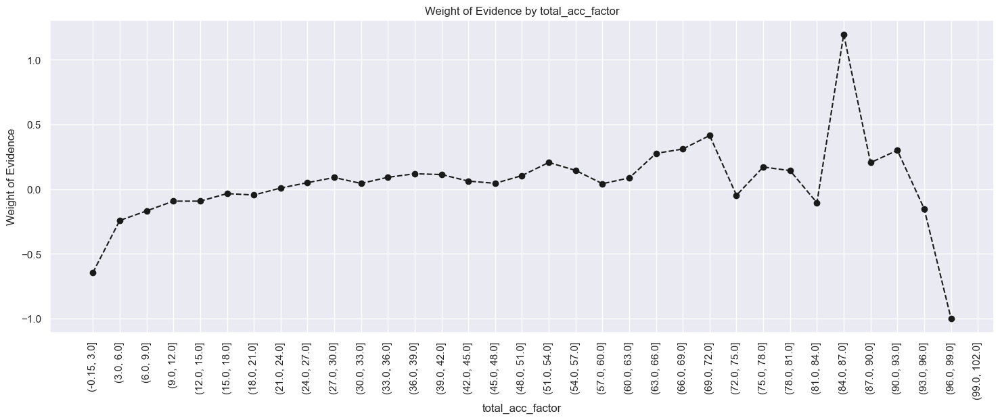

In [204]:
plot_by_woe(df_total_acc, 90)

In [205]:
#Split into categorical:
# Categories: '<=27', '28-51', '>51'
x_train['total_acc:<=27'] = np.where((x_train['total_acc'] <= 27), 1, 0)
x_train['total_acc:28-51'] = np.where((x_train['total_acc'] >= 28) & (x_train['total_acc'] <= 51), 1, 0)
x_train['total_acc:>=52'] = np.where((x_train['total_acc'] >= 52), 1, 0)

In [206]:
#For acc_now_delinq
df_acc_now_delinq, IV_acc_now_delinq = woe_ordered_continuous(x_train, 'acc_now_delinq', y_train)
df_acc_now_delinq

,acc_now_delinq,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,371682,0.890648,0.996392,331038.0,40644.0,0.996352,0.996714,-0.000363,NaN,NaN,1.313328e-07
1,1.0,1263,0.899446,0.003386,1136.0,127.0,0.003419,0.003114,0.093337,0.008797,0.093700,2.843849e-05
2,2.0,70,0.928571,0.000188,65.0,5.0,0.000196,0.000123,0.467204,0.029126,0.373868,3.411558e-05
3,3.0,7,0.857143,0.000019,6.0,1.0,0.000018,0.000025,-0.305986,0.071429,0.773190,1.977993e-06
4,4.0,4,1.000000,0.000011,4.0,0.0,0.000012,0.000000,inf,0.142857,inf,inf
5,5.0,2,0.500000,0.000005,1.0,1.0,0.000003,0.000025,-2.097745,0.500000,inf,4.512930e-05


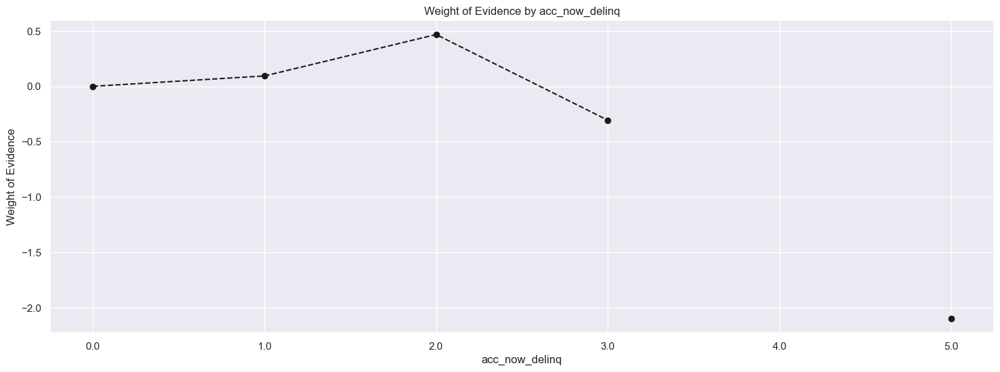

In [207]:
plot_by_woe(df_acc_now_delinq)

In [208]:
#Split into categories:

# Categories: '0', '>=1'
x_train['acc_now_delinq:0'] = np.where((x_train['acc_now_delinq'] == 0), 1, 0)
x_train['acc_now_delinq:>=1'] = np.where((x_train['acc_now_delinq'] >= 1), 1, 0)

In [211]:
#For total_rev_hi_lim
x_train['total_rev_hi_lim_factor'] = pd.cut(x_train['total_rev_hi_lim'], 2000)
df_total_rev_hi_lim, IV_total_rev_hi_lim = woe_ordered_continuous(x_train, 'total_rev_hi_lim_factor', y_train)


/Users/mckishiebombom/.pyenv/versions/3.10.6/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


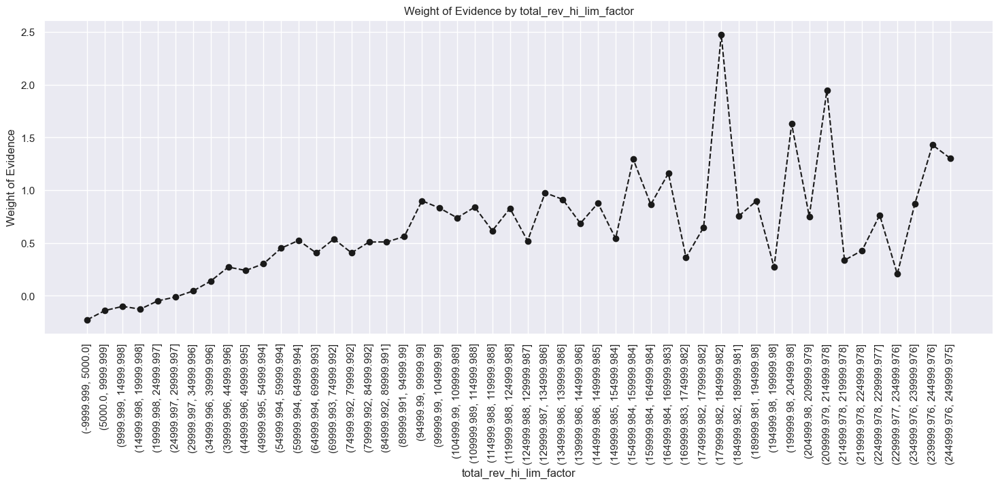

In [212]:
plot_by_woe(df_total_rev_hi_lim.iloc[: 50, : ], 90)

In [213]:
# Split into categories:
# '<=5K', '5K-10K', '10K-20K', '20K-30K', '30K-40K', '40K-55K', '55K-95K', '>95K'
x_train['total_rev_hi_lim:<=5K'] = np.where((x_train['total_rev_hi_lim'] <= 5000), 1, 0)
x_train['total_rev_hi_lim:5K-10K'] = np.where((x_train['total_rev_hi_lim'] > 5000) & (x_train['total_rev_hi_lim'] <= 10000), 1, 0)
x_train['total_rev_hi_lim:10K-20K'] = np.where((x_train['total_rev_hi_lim'] > 10000) & (x_train['total_rev_hi_lim'] <= 20000), 1, 0)
x_train['total_rev_hi_lim:20K-30K'] = np.where((x_train['total_rev_hi_lim'] > 20000) & (x_train['total_rev_hi_lim'] <= 30000), 1, 0)
x_train['total_rev_hi_lim:30K-40K'] = np.where((x_train['total_rev_hi_lim'] > 30000) & (x_train['total_rev_hi_lim'] <= 40000), 1, 0)
x_train['total_rev_hi_lim:40K-55K'] = np.where((x_train['total_rev_hi_lim'] > 40000) & (x_train['total_rev_hi_lim'] <= 55000), 1, 0)
x_train['total_rev_hi_lim:55K-95K'] = np.where((x_train['total_rev_hi_lim'] > 55000) & (x_train['total_rev_hi_lim'] <= 95000), 1, 0)
x_train['total_rev_hi_lim:>95K'] = np.where((x_train['total_rev_hi_lim'] > 95000), 1, 0)

In [214]:
#For 'installement':
x_train['installment_factor'] = pd.cut(x_train['installment'], 50)

df_installment, IV_installment = woe_ordered_continuous(x_train, 'installment_factor', y_train)
df_installment


,installment_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(14.276, 43.556]",1812,0.906181,0.004858,1642.0,170.0,0.004942,0.004169,0.170127,NaN,NaN,1.315331e-04
1,"(43.556, 71.443]",4841,0.897542,0.012978,4345.0,496.0,0.013078,0.012163,0.072460,0.008639,0.097667,6.623439e-05
2,"(71.443, 99.329]",6824,0.893025,0.018294,6094.0,730.0,0.018342,0.017902,0.024270,0.004517,0.048190,1.067415e-05
3,"(99.329, 127.216]",9138,0.890348,0.024497,8136.0,1002.0,0.024488,0.024572,-0.003444,0.002677,0.027715,2.910056e-07
4,"(127.216, 155.102]",10040,0.896514,0.026915,9001.0,1039.0,0.027091,0.025479,0.061332,0.006166,0.064776,9.884391e-05
5,"(155.102, 182.988]",16816,0.894208,0.045080,15037.0,1779.0,0.045258,0.043626,0.036717,0.002306,0.024615,5.990905e-05
6,"(182.988, 210.875]",17216,0.904798,0.046152,15577.0,1639.0,0.046883,0.040193,0.153964,0.010590,0.117247,1.030040e-03
7,"(210.875, 238.761]",15090,0.900398,0.040453,13587.0,1503.0,0.040894,0.036858,0.103905,0.004400,0.050059,4.193408e-04
8,"(238.761, 266.648]",18842,0.901391,0.050511,16984.0,1858.0,0.051118,0.045564,0.115026,0.000993,0.011121,6.388952e-04
9,"(266.648, 294.534]",20100,0.891095,0.053883,17911.0,2189.0,0.053908,0.053681,0.004225,0.010296,0.110801,9.603802e-07


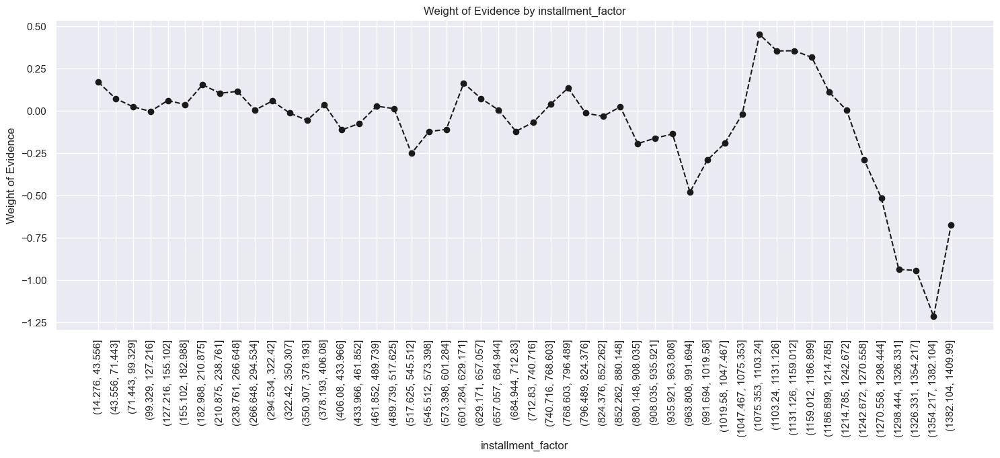

In [215]:
plot_by_woe(df_installment, 90)

In [216]:
#For annual_inc:
x_train['annual_inc_factor'] = pd.cut(x_train['annual_inc'], 100)
df_annual_inc, IV_annual_inc = woe_ordered_continuous(x_train, 'annual_inc_factor', y_train)
df_annual_inc

,annual_inc_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-5243.882, 73294.82]",231445,0.875901,0.620449,202723.0,28722.0,0.610152,0.704350,-0.143568,NaN,NaN,0.013524
1,"(73294.82, 144693.64]",120459,0.912900,0.322922,109967.0,10492.0,0.330977,0.257296,0.251822,0.036998,0.395390,0.018555
2,"(144693.64, 216092.46]",15885,0.925087,0.042584,14695.0,1190.0,0.044229,0.029182,0.415809,0.012187,0.163987,0.006256
3,"(216092.46, 287491.28]",3119,0.927220,0.008361,2892.0,227.0,0.008704,0.005567,0.447009,0.002134,0.031200,0.001403
4,"(287491.28, 358890.1]",1117,0.929275,0.002994,1038.0,79.0,0.003124,0.001937,0.477858,0.002055,0.030850,0.000567
5,"(358890.1, 430288.92]",408,0.933824,0.001094,381.0,27.0,0.001147,0.000662,0.549218,0.004549,0.071359,0.000266
6,"(430288.92, 501687.74]",245,0.946939,0.000657,232.0,13.0,0.000698,0.000319,0.784043,0.013115,0.234826,0.000298
7,"(501687.74, 573086.56]",87,0.919540,0.000233,80.0,7.0,0.000241,0.000172,0.338372,0.027399,0.445672,0.000023
8,"(573086.56, 644485.38]",61,0.868852,0.000164,53.0,8.0,0.000160,0.000196,-0.206895,0.050688,0.545266,0.000008
9,"(644485.38, 715884.2]",51,0.901961,0.000137,46.0,5.0,0.000138,0.000123,0.121459,0.033108,0.328353,0.000002


In [217]:
#Splitting into high income and low income individuals:
# Assuming that $140,000 is the threshold above which individuals are considered to have high incomen.

df_annual_inc_temp = x_train.loc[x_train['annual_inc'] <= 140000, : ]
df_annual_inc_temp['annual_inc_factor'] = pd.cut(df_annual_inc_temp['annual_inc'], 50)
df_temp_annual_inc, IV_temp_annual_inc = woe_ordered_continuous(df_annual_inc_temp, 'annual_inc_factor', y_train[df_annual_inc_temp.index])
df_temp_annual_inc

/var/folders/k_/p3kns8712g36qk02pv5vmss40000gn/T/ipykernel_92285/1962156087.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_annual_inc_temp['annual_inc_factor'] = pd.cut(df_annual_inc_temp['annual_inc'], 50)


,annual_inc_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(1757.896, 4658.08]",15,0.800000,0.000043,12.0,3.0,0.000038,0.000077,-0.689458,NaN,NaN,0.000026
1,"(4658.08, 7420.16]",40,0.750000,0.000114,30.0,10.0,0.000096,0.000256,-0.977140,0.050000,0.287682,0.000156
2,"(7420.16, 10182.24]",287,0.874564,0.000818,251.0,36.0,0.000805,0.000920,-0.133818,0.124564,0.843322,0.000015
3,"(10182.24, 12944.32]",547,0.828154,0.001558,453.0,94.0,0.001452,0.002402,-0.503155,0.046411,0.369337,0.000478
4,"(12944.32, 15706.4]",1210,0.830579,0.003447,1005.0,205.0,0.003222,0.005238,-0.486019,0.002425,0.017135,0.000980
5,"(15706.4, 18468.48]",1522,0.847569,0.004335,1290.0,232.0,0.004136,0.005928,-0.360092,0.016990,0.125927,0.000646
6,"(18468.48, 21230.56]",2928,0.855533,0.008340,2505.0,423.0,0.008031,0.010809,-0.297080,0.007964,0.063012,0.000825
7,"(21230.56, 23992.64]",2495,0.844489,0.007107,2107.0,388.0,0.006755,0.009914,-0.383737,0.011044,0.086657,0.001212
8,"(23992.64, 26754.72]",7016,0.848632,0.019985,5954.0,1062.0,0.019088,0.027137,-0.351843,0.004143,0.031894,0.002832
9,"(26754.72, 29516.8]",5643,0.857345,0.016074,4838.0,805.0,0.015510,0.020570,-0.282338,0.008714,0.069505,0.001429


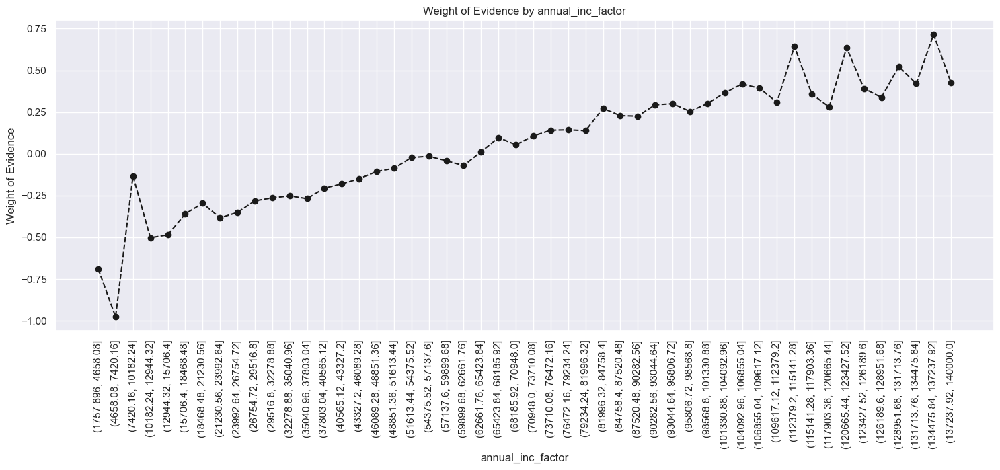

In [218]:
plot_by_woe(df_temp_annual_inc, 90)

#Increases monotonously

In [219]:
#Taking into consideration: Number of observations as well:
# WoE is monotonically decreasing with income, so we split income in 10 equal categories, each with width of 15k.

x_train['annual_inc:<20K'] = np.where((x_train['annual_inc'] <= 20000), 1, 0)
x_train['annual_inc:20K-30K'] = np.where((x_train['annual_inc'] > 20000) & (x_train['annual_inc'] <= 30000), 1, 0)
x_train['annual_inc:30K-40K'] = np.where((x_train['annual_inc'] > 30000) & (x_train['annual_inc'] <= 40000), 1, 0)
x_train['annual_inc:40K-50K'] = np.where((x_train['annual_inc'] > 40000) & (x_train['annual_inc'] <= 50000), 1, 0)
x_train['annual_inc:50K-60K'] = np.where((x_train['annual_inc'] > 50000) & (x_train['annual_inc'] <= 60000), 1, 0)
x_train['annual_inc:60K-70K'] = np.where((x_train['annual_inc'] > 60000) & (x_train['annual_inc'] <= 70000), 1, 0)
x_train['annual_inc:70K-80K'] = np.where((x_train['annual_inc'] > 70000) & (x_train['annual_inc'] <= 80000), 1, 0)
x_train['annual_inc:80K-90K'] = np.where((x_train['annual_inc'] > 80000) & (x_train['annual_inc'] <= 90000), 1, 0)
x_train['annual_inc:90K-100K'] = np.where((x_train['annual_inc'] > 90000) & (x_train['annual_inc'] <= 100000), 1, 0)
x_train['annual_inc:100K-120K'] = np.where((x_train['annual_inc'] > 100000) & (x_train['annual_inc'] <= 120000), 1, 0)
x_train['annual_inc:120K-140K'] = np.where((x_train['annual_inc'] > 120000) & (x_train['annual_inc'] <= 140000), 1, 0)
x_train['annual_inc:>140K'] = np.where((x_train['annual_inc'] > 140000), 1, 0)

In [221]:
#For 'mths_since_deliq': -> contains a lot of missing values:
#pd.notnull used to select non-missing values:

df_mths_since_deliq_temp = x_train[pd.notnull(x_train['mths_since_last_delinq'])]
df_mths_since_deliq_temp['mths_since_last_delinq_factor'] = pd.cut(df_mths_since_deliq_temp['mths_since_last_delinq'], 50)
df_mths_since_deliq, IV_mths_since_deliq_temp = woe_ordered_continuous(df_mths_since_deliq_temp, 'mths_since_last_delinq_factor', y_train[df_mths_since_deliq_temp.index])
df_mths_since_deliq

/var/folders/k_/p3kns8712g36qk02pv5vmss40000gn/T/ipykernel_92285/1100691944.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mths_since_deliq_temp['mths_since_last_delinq_factor'] = pd.cut(df_mths_since_deliq_temp['mths_since_last_delinq'], 50)


,mths_since_last_delinq_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.188, 3.76]",5277,0.871518,0.030531,4599.0,678.0,0.029814,0.036481,-0.201825,NaN,NaN,1.345636e-03
1,"(3.76, 7.52]",11167,0.887615,0.064608,9912.0,1255.0,0.064256,0.067528,-0.049661,0.016097,0.152164,1.624709e-04
2,"(7.52, 11.28]",13306,0.892830,0.076983,11880.0,1426.0,0.077014,0.076729,0.003711,0.005215,0.053372,1.058786e-06
3,"(11.28, 15.04]",13216,0.888847,0.076462,11747.0,1469.0,0.076152,0.079042,-0.037256,0.003983,0.040967,1.076913e-04
4,"(15.04, 18.8]",9337,0.894934,0.054020,8356.0,981.0,0.054169,0.052785,0.025891,0.006087,0.063147,3.584565e-05
5,"(18.8, 22.56]",11641,0.892707,0.067350,10392.0,1249.0,0.067368,0.067205,0.002421,0.002227,0.023470,3.944869e-07
6,"(22.56, 26.32]",10887,0.896298,0.062988,9758.0,1129.0,0.063258,0.060748,0.040483,0.003592,0.038062,1.016031e-04
7,"(26.32, 30.08]",10560,0.895076,0.061096,9452.0,1108.0,0.061274,0.059618,0.027398,0.001223,0.013085,4.537112e-05
8,"(30.08, 33.84]",7576,0.902191,0.043832,6835.0,741.0,0.044309,0.039871,0.105539,0.007115,0.078141,4.683861e-04
9,"(33.84, 37.6]",9795,0.897397,0.056670,8790.0,1005.0,0.056982,0.054076,0.052355,0.004794,0.053184,1.521758e-04


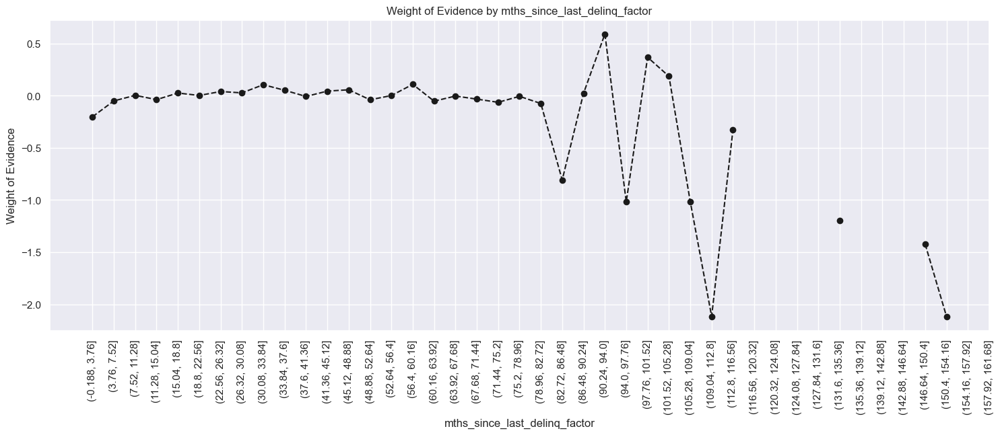

In [222]:
plot_by_woe(df_mths_since_deliq, 90)

In [223]:
#Split into categorical:
# Categories: Missing, 0-3, 4-30, 31-56, >=57
x_train['mths_since_last_delinq:Missing'] = np.where((x_train['mths_since_last_delinq'].isnull()), 1, 0)
x_train['mths_since_last_delinq:0-3'] = np.where((x_train['mths_since_last_delinq'] >= 0) & (x_train['mths_since_last_delinq'] <= 3), 1, 0)
x_train['mths_since_last_delinq:4-30'] = np.where((x_train['mths_since_last_delinq'] >= 4) & (x_train['mths_since_last_delinq'] <= 30), 1, 0)
x_train['mths_since_last_delinq:31-56'] = np.where((x_train['mths_since_last_delinq'] >= 31) & (x_train['mths_since_last_delinq'] <= 56), 1, 0)
x_train['mths_since_last_delinq:>=57'] = np.where((x_train['mths_since_last_delinq'] >= 57), 1, 0)

In [224]:
#For dti:
x_train['dti_factor'] = pd.cut(x_train['dti'], 100)

df_dti, IV_dti = woe_ordered_continuous(x_train, 'dti_factor', y_train)
df_dti

,dti_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.04, 0.4]",745,0.876510,0.001997,653.0,92.0,0.001965,0.002256,-0.137956,NaN,NaN,4.010821e-05
1,"(0.4, 0.8]",808,0.919554,0.002166,743.0,65.0,0.002236,0.001594,0.338564,4.304439e-02,4.765202e-01,2.174497e-04
2,"(0.8, 1.2]",922,0.896963,0.002472,827.0,95.0,0.002489,0.002330,0.066183,2.259133e-02,2.723810e-01,1.054967e-05
3,"(1.2, 1.6]",1043,0.896453,0.002796,935.0,108.0,0.002814,0.002648,0.060670,5.105829e-04,5.512501e-03,1.005059e-05
4,"(1.6, 2.0]",1172,0.902730,0.003142,1058.0,114.0,0.003184,0.002796,0.130192,6.277835e-03,6.952186e-02,5.060883e-05
5,"(2.0, 2.399]",1337,0.916978,0.003584,1226.0,111.0,0.003690,0.002722,0.304237,1.424793e-02,1.740448e-01,2.944820e-04
6,"(2.399, 2.799]",1538,0.916125,0.004123,1409.0,129.0,0.004241,0.003163,0.293078,8.534722e-04,1.115881e-02,3.157366e-04
7,"(2.799, 3.199]",1696,0.904481,0.004547,1534.0,162.0,0.004617,0.003973,0.150293,1.164371e-02,1.427855e-01,9.682979e-05
8,"(3.199, 3.599]",1927,0.900363,0.005166,1735.0,192.0,0.005222,0.004708,0.103522,4.117873e-03,4.677033e-02,5.316392e-05
9,"(3.599, 3.999]",2197,0.914429,0.005890,2009.0,188.0,0.006047,0.004610,0.271205,1.406551e-02,1.676831e-01,3.895385e-04


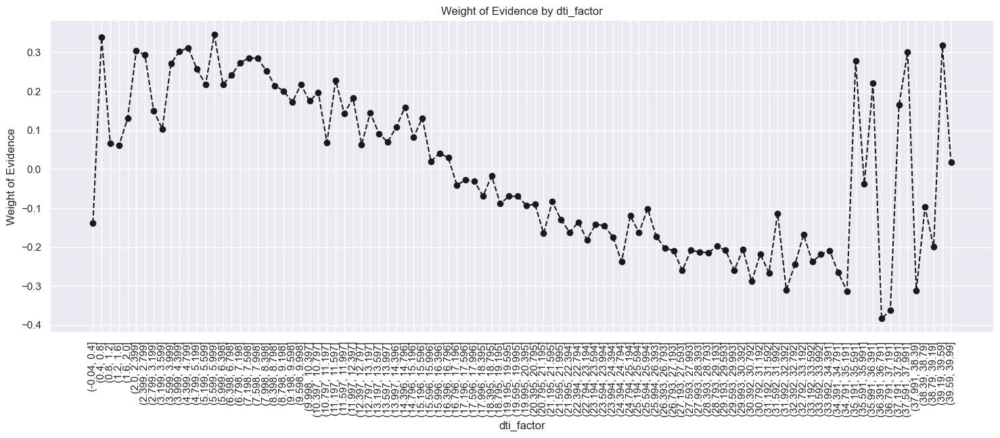

In [225]:
plot_by_woe(df_dti, 90)

/var/folders/k_/p3kns8712g36qk02pv5vmss40000gn/T/ipykernel_92285/2074320379.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_dti_temp['dti_factor'] = pd.cut(df_dti_temp['dti'], 50)


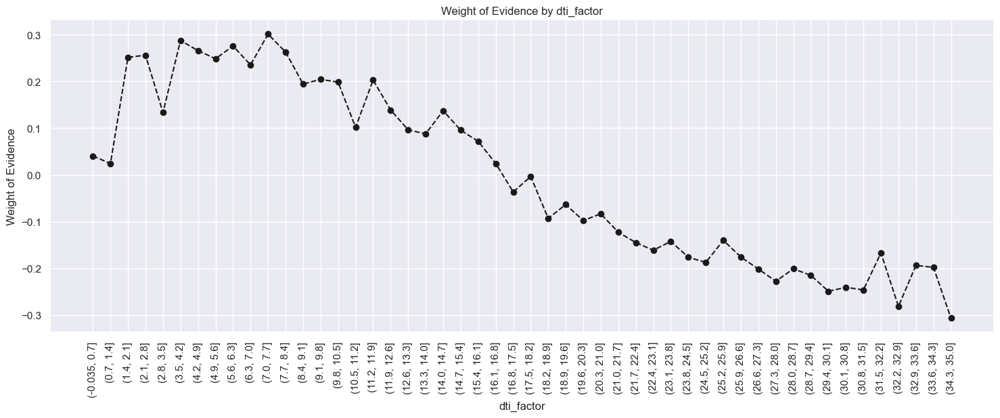

In [227]:
#One categoty for more than 35.
#Determine the categories of individuals with 150k or less
df_dti_temp = x_train.loc[x_train['dti'] <= 35, : ]

#Fine Classing:
df_dti_temp['dti_factor'] = pd.cut(df_dti_temp['dti'], 50)

df_temp_dti, IV_temp_dti= woe_ordered_continuous(df_dti_temp, 'dti_factor', y_train[df_dti_temp.index])

#Plot WoE:
plot_by_woe(df_temp_dti, 90)

In [228]:
#Split into categories:
x_train['dti:<=1.4'] = np.where((x_train['dti'] <= 1.4), 1, 0)
x_train['dti:1.4-3.5'] = np.where((x_train['dti'] > 1.4) & (x_train['dti'] <= 3.5), 1, 0)
x_train['dti:3.5-7.7'] = np.where((x_train['dti'] > 3.5) & (x_train['dti'] <= 7.7), 1, 0)
x_train['dti:7.7-10.5'] = np.where((x_train['dti'] > 7.7) & (x_train['dti'] <= 10.5), 1, 0)
x_train['dti:10.5-16.1'] = np.where((x_train['dti'] > 10.5) & (x_train['dti'] <= 16.1), 1, 0)
x_train['dti:16.1-20.3'] = np.where((x_train['dti'] > 16.1) & (x_train['dti'] <= 20.3), 1, 0)
x_train['dti:20.3-21.7'] = np.where((x_train['dti'] > 20.3) & (x_train['dti'] <= 21.7), 1, 0)
x_train['dti:21.7-22.4'] = np.where((x_train['dti'] > 21.7) & (x_train['dti'] <= 22.4), 1, 0)
x_train['dti:22.4-35'] = np.where((x_train['dti'] > 22.4) & (x_train['dti'] <= 35), 1, 0)
x_train['dti:>35'] = np.where((x_train['dti'] > 35), 1, 0)

In [231]:
#For mths_since_last_record:

#One category for missing values, and do fine and coarse classing:
df_mths_since_last_record_temp = x_train[pd.notnull(x_train['mths_since_last_record'])]

#Fine Classing -> Split into 50 categories:
df_mths_since_last_record_temp['mths_since_last_record_factor'] = pd.cut(df_mths_since_last_record_temp['mths_since_last_record'], 50)

df_mths_since_last_record, IV_mths_since_last_record = woe_ordered_continuous(df_mths_since_last_record_temp, 'mths_since_last_record_factor', y_train[df_mths_since_last_record_temp.index])
df_mths_since_last_record

/var/folders/k_/p3kns8712g36qk02pv5vmss40000gn/T/ipykernel_92285/2542271531.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mths_since_last_record_temp['mths_since_last_record_factor'] = pd.cut(df_mths_since_last_record_temp['mths_since_last_record'], 50)


,mths_since_last_record_factor,num_obs,prop_good,prop_num_obs,n_good,n_bad,prop_num_good,prop_num_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.121, 2.42]",1086,0.764273,0.021691,830.0,256.0,0.018569,0.047672,-0.942830,NaN,NaN,2.743898e-02
1,"(2.42, 4.84]",76,0.894737,0.001518,68.0,8.0,0.001521,0.001490,0.020988,0.130464,0.963818,6.631477e-07
2,"(4.84, 7.26]",163,0.914110,0.003256,149.0,14.0,0.003334,0.002607,0.245810,0.019374,0.224823,1.785766e-04
3,"(7.26, 9.68]",156,0.903846,0.003116,141.0,15.0,0.003155,0.002793,0.121631,0.010264,0.124179,4.394269e-05
4,"(9.68, 12.1]",292,0.907534,0.005832,265.0,27.0,0.005929,0.005028,0.164814,0.003688,0.043183,1.484775e-04
5,"(12.1, 14.52]",207,0.917874,0.004134,190.0,17.0,0.004251,0.003166,0.294732,0.010340,0.129918,3.198166e-04
6,"(14.52, 16.94]",210,0.928571,0.004194,195.0,15.0,0.004363,0.002793,0.445871,0.010697,0.151139,6.997555e-04
7,"(16.94, 19.36]",334,0.907186,0.006671,303.0,31.0,0.006779,0.005773,0.160667,0.021386,0.285204,1.616579e-04
8,"(19.36, 21.78]",283,0.936396,0.005652,265.0,18.0,0.005929,0.003352,0.570280,0.029210,0.409612,1.469527e-03
9,"(21.78, 24.2]",455,0.898901,0.009088,409.0,46.0,0.009151,0.008566,0.065995,0.037495,0.504284,3.856726e-05


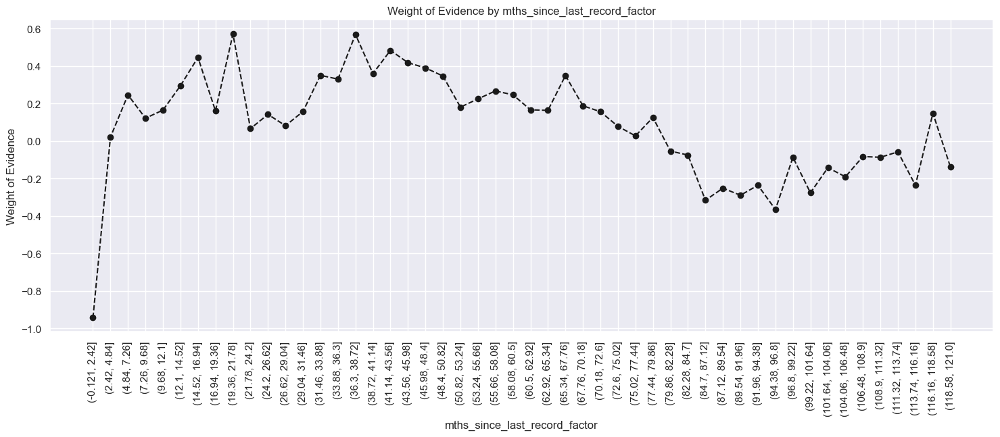

In [232]:
plot_by_woe(df_mths_since_last_record, 90)

In [233]:
# Split into Categories: 'Missing', '0-2', '3-20', '21-31', '32-80', '81-86', '>86'
x_train['mths_since_last_record:Missing'] = np.where((x_train['mths_since_last_record'].isnull()), 1, 0)
x_train['mths_since_last_record:0-2'] = np.where((x_train['mths_since_last_record'] >= 0) & (x_train['mths_since_last_record'] <= 2), 1, 0)
x_train['mths_since_last_record:3-20'] = np.where((x_train['mths_since_last_record'] >= 3) & (x_train['mths_since_last_record'] <= 20), 1, 0)
x_train['mths_since_last_record:21-31'] = np.where((x_train['mths_since_last_record'] >= 21) & (x_train['mths_since_last_record'] <= 31), 1, 0)
x_train['mths_since_last_record:32-80'] = np.where((x_train['mths_since_last_record'] >= 32) & (x_train['mths_since_last_record'] <= 80), 1, 0)
x_train['mths_since_last_record:81-86'] = np.where((x_train['mths_since_last_record'] >= 81) & (x_train['mths_since_last_record'] <= 86), 1, 0)
x_train['mths_since_last_record:>86'] = np.where((x_train['mths_since_last_record'] > 86), 1, 0)

Preprocessing Test Dataset

In [234]:
#####
# loan_data_inputs_train = x_train
# loan_data_targets_train = y_train

#####
# loan_data_inputs_test = df_inputs_prepr
# loan_data_targets_test = df_targets_prepr

In [ ]:
# loan_data_inputs_train.to_csv('/Users/mckishiebombom/Desktop/credit-risk/loan_data_inputs_train.csv')
# loan_data_targets_train.to_csv('/Users/mckishiebombom/Desktop/credit-risk/loan_data_targets_train.csv')
# loan_data_inputs_test.to_csv('/Users/mckishiebombom/Desktop/credit-risk/loan_data_inputs_test.csv')
# loan_data_targets_test.to_csv('/Users/mckishiebombom/Desktop/credit-risk/loan_data_targets_test.csv')